In this notebook, I will perform an in silico gene perturbation analysis, following the CellOracle tutorial provided in the link below. This analysis leverages the CellOracle package to simulate gene knockouts and study their effects on gene regulatory networks and RNA expression.

I am grateful to the team at CellOracle for creating this incredible tool and to all data providers for their invaluable contributions. The tutorial link is provided below:

CellOracle: 

https://morris-lab.github.io/CellOracle.documentation/

Data Providers:

https://www.nature.com/articles/s41597-023-02373-y#Sec18
https://www.biorxiv.org/content/10.1101/2023.03.06.531398v2


In [ ]:
!pip install scanpy louvain igraph genomepy celloracle

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams["savefig.dpi"] = 300
plt.rcParams["figure.figsize"] = [6, 4.5]

import celloracle as co
from celloracle.applications import Pseudotime_calculator
co.__version__

import copy
import glob
import time
import os
import shutil
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from tqdm.auto import tqdm

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns


import os, sys, shutil, importlib, glob
from tqdm.notebook import tqdm
from celloracle import motif_analysis as ma
import celloracle as co
co.__version__

/usr/local/lib/python3.10/dist-packages/loompy/bus_file.py:68: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def twobit_to_dna(twobit: int, size: int) -> str:
/usr/local/lib/python3.10/dist-packages/loompy/bus_file.py:85: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def dna_to_twobit(dna: str) -> int:
/usr/local/lib/python3.10/dist-packages/loompy/bus_file.py:1

'0.18.0'

In [ ]:
scrna_path = "zf_atlas_full_v4_release.h5ad"
adata_rna = sc.read_h5ad(scrna_path)


In [ ]:
selected_time_points = ["10hpf", "12hpf", "24hpf"]
# Filter the AnnData object to keep only cells from the selected time points
adata_rna_combined = adata_rna[adata_rna.obs['timepoint'].isin(selected_time_points)].copy()
adata_rna_combined

AnnData object with n_obs × n_vars = 20864 × 32060
    obs: 'n_genes', 'n_counts', 'fish', 'timepoint_cluster', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_nc', 'pct_counts_nc', 'developmental_stage', 'timepoint', 'zebrafish_anatomy_ontology_class', 'zebrafish_anatomy_ontology_id'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'nc', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'global_annotation_colors', 'timepoint_colors', 'zebrafish_anatomy_ontology_class_colors', 'zebrafish_anatomy_ontology_id_colors'
    obsm: 'X_umap'
    layers: 'counts'

In [ ]:
sc.pp.filter_genes(adata_rna_combined, min_counts=1)
sc.pp.normalize_per_cell(adata_rna_combined, key_n_counts='n_counts_all')
# Select top 2000 highly-variable genes
filter_result = sc.pp.filter_genes_dispersion(adata_rna_combined.X,
                                              flavor='cell_ranger',
                                              n_top_genes=2000,
                                              log=False)

# Subset the genes
adata_rna_combined = adata_rna_combined[:, filter_result.gene_subset]

# Renormalize after filtering
sc.pp.normalize_per_cell(adata_rna_combined)

adata_rna_combined.raw = adata_rna_combined
adata_rna_combined.layers["raw_count"] = adata_rna_combined.raw.X.copy()


# Log transformation and scaling
sc.pp.log1p(adata_rna_combined)
sc.pp.scale(adata_rna_combined)


In [ ]:

# PCA
sc.tl.pca(adata_rna_combined, svd_solver='arpack')

# Diffusion map
sc.pp.neighbors(adata_rna_combined, n_neighbors=4, n_pcs=20)

sc.tl.diffmap(adata_rna_combined)
# Calculate neihbors again based on diffusionmap
sc.pp.neighbors(adata_rna_combined, n_neighbors=10, use_rep='X_diffmap')

/usr/local/lib/python3.10/dist-packages/scipy/sparse/_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [ ]:

sc.tl.louvain(adata_rna_combined, resolution=0.8)


## **Combined-HPF**

In [ ]:
zf_classes=list(adata_rna_combined.obs['zebrafish_anatomy_ontology_class'].unique())


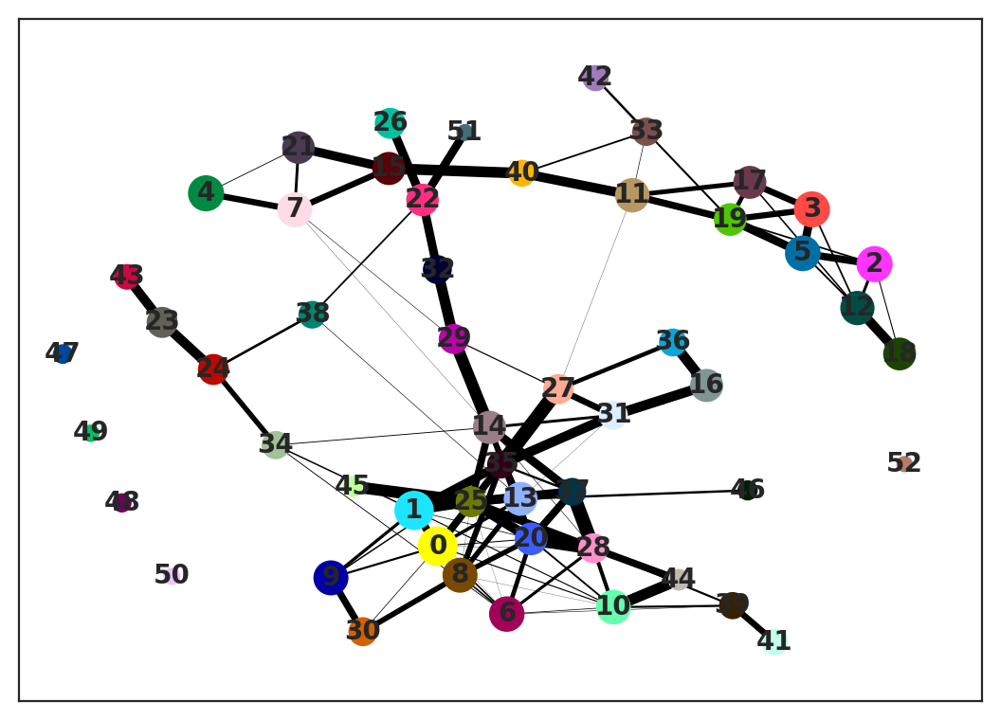

In [ ]:
sc.tl.paga(adata_rna_combined, groups='louvain')
plt.rcParams["figure.figsize"] = [6, 4.5]

sc.pl.paga(adata_rna_combined)


In [ ]:
sc.tl.draw_graph(adata_rna_combined, init_pos='paga', random_state=123)


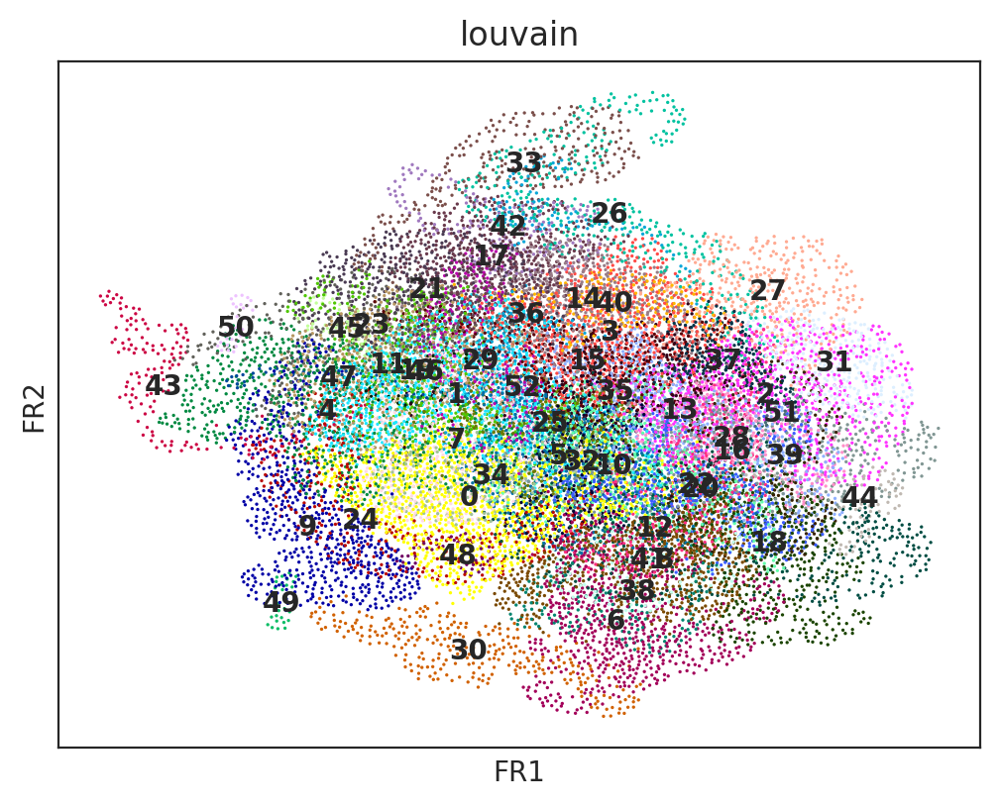

In [ ]:
sc.pl.draw_graph(adata_rna_combined, color='louvain', legend_loc='on data')


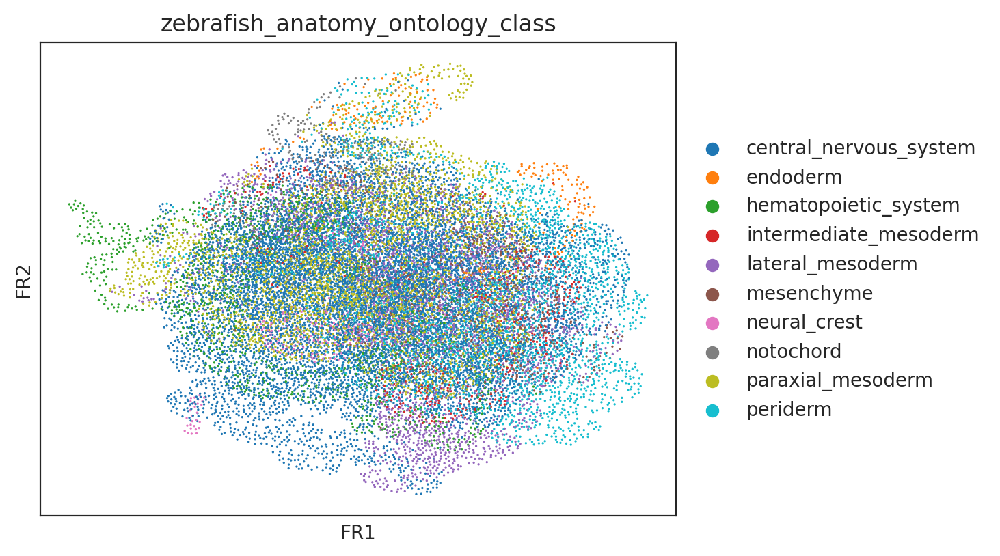

In [ ]:
sc.pl.draw_graph(adata_rna_combined, color='zebrafish_anatomy_ontology_class')


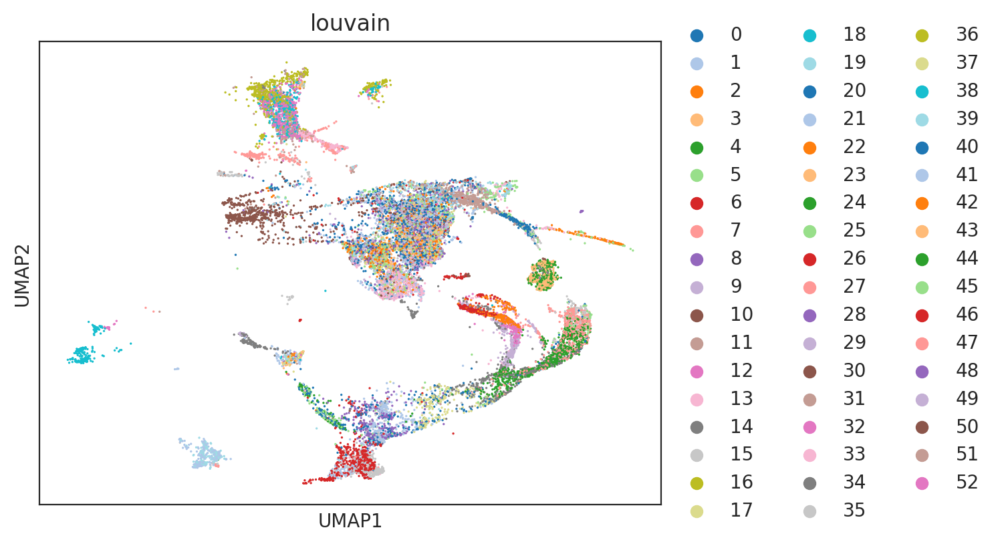

In [ ]:
import matplotlib.pyplot as plt
sc.pl.umap(adata_rna_combined, color='louvain', palette=plt.cm.tab20.colors)

marker gene of mesoderm


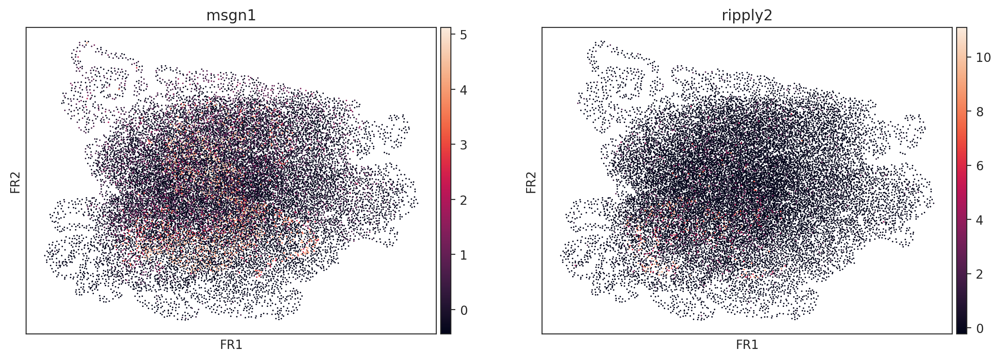

marker gene of periderm


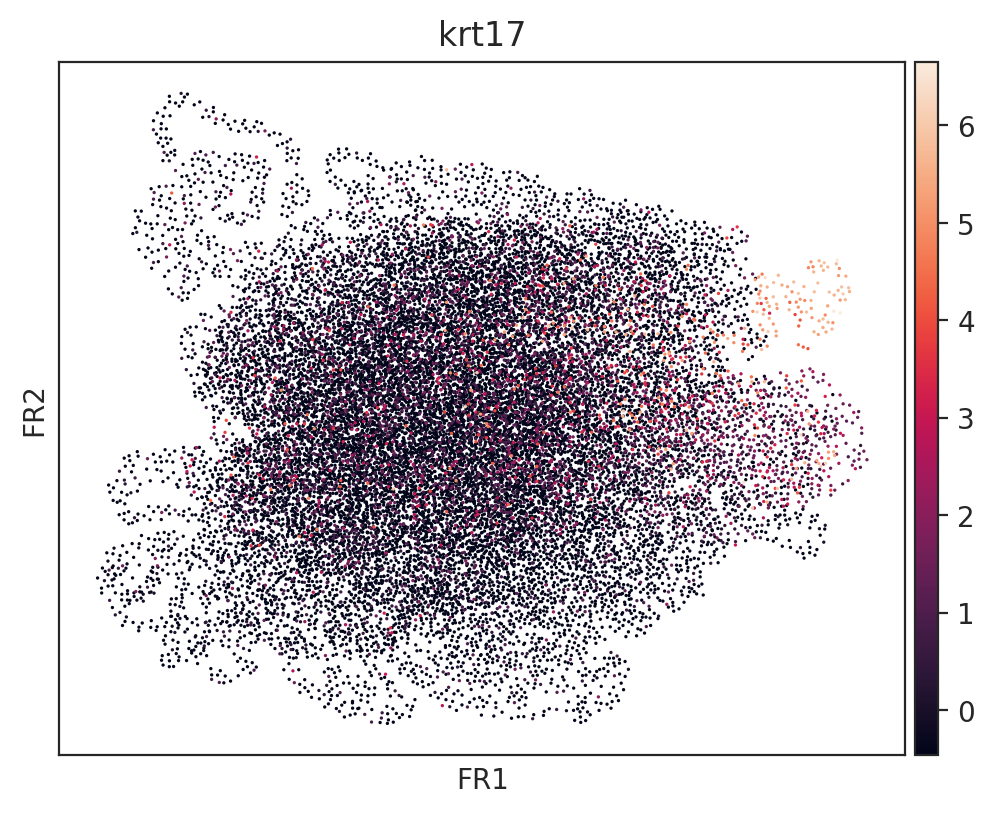

marker gene of intermediate mesoderm


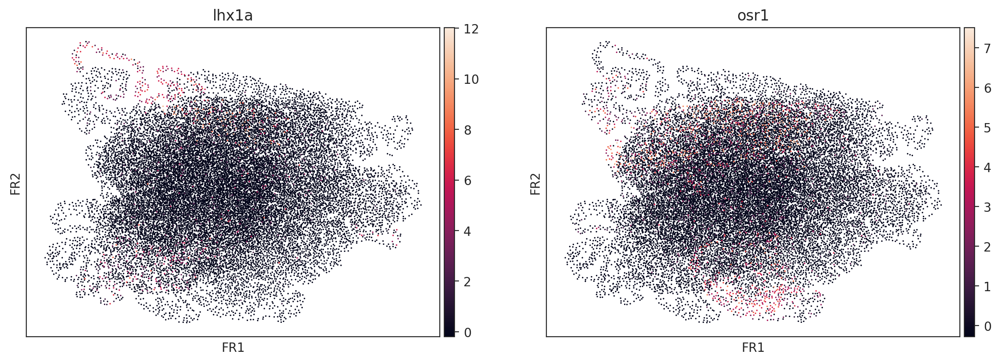

In [ ]:
markers = {"mesoderm":["msgn1","ripply2"],
           "periderm":["krt17"],
           "intermediate mesoderm":["lhx1a","osr1"]



            }

for cell_type, genes in markers.items():
    print(f"marker gene of {cell_type}")
    sc.pl.draw_graph(adata_rna_combined, color=genes, use_raw=False, ncols=2)
    plt.show()

In [ ]:
pt = Pseudotime_calculator(adata=adata_rna_combined,
                           obsm_key="X_draw_graph_fr", # Dimensional reduction data name
                           cluster_column_name="zebrafish_anatomy_ontology_class" # Clustering data name
                           )

Clustering name:  zebrafish_anatomy_ontology_class
Cluster list ['central_nervous_system', 'endoderm', 'hematopoietic_system', 'intermediate_mesoderm', 'lateral_mesoderm', 'mesenchyme', 'neural_crest', 'notochord', 'paraxial_mesoderm', 'periderm']


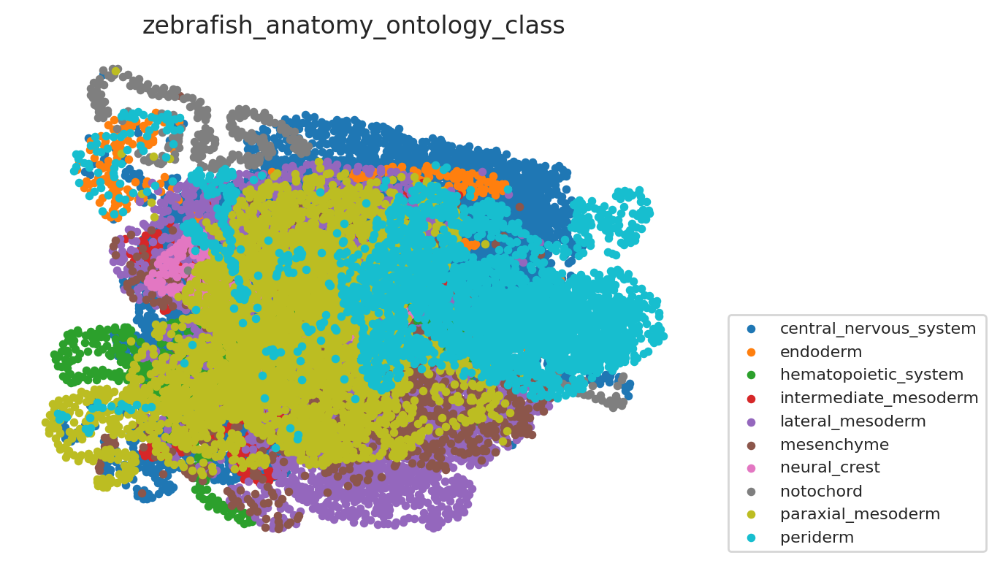

In [ ]:
print("Clustering name: ", pt.cluster_column_name)
print("Cluster list", pt.cluster_list)
pt.plot_cluster(fontsize=8)

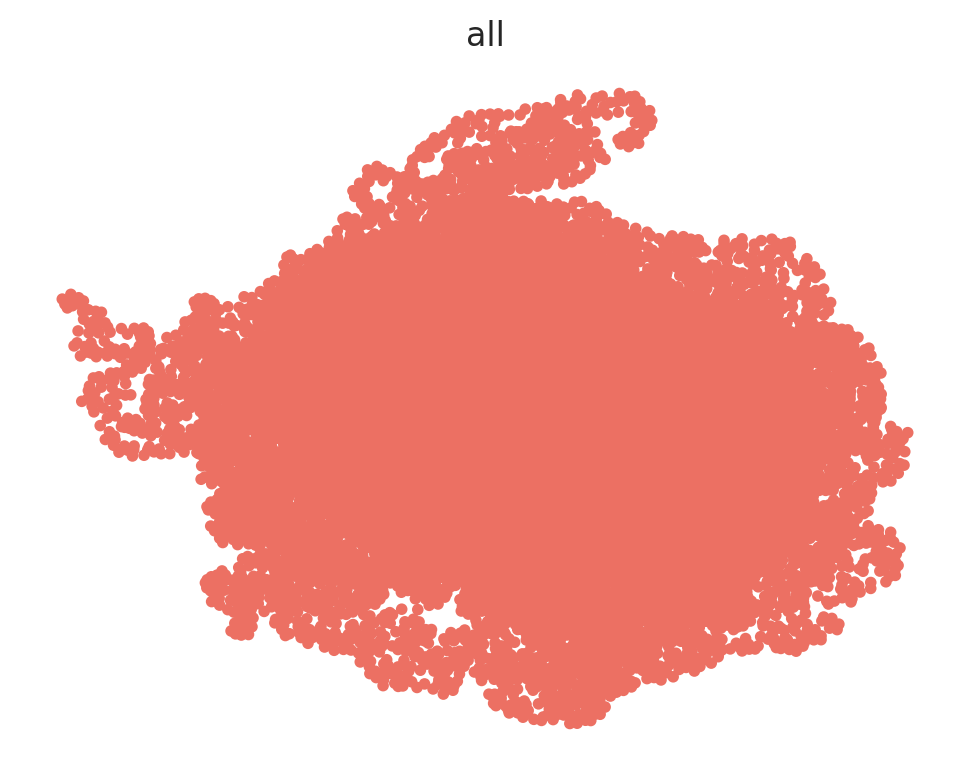

In [ ]:
# whole = ['0', '1', '2','3' ,'4', '5',
#                           '6', '7', '8', '9', '10', '11','12', '13', '14', '15', '16', '17',
#                           '18', '19', '20', '21', '22', '23','24','25', '26','27']
whole= zf_classes
# Make a dictionary
lineage_dictionary = {"all": whole}

# Input lineage information into pseudotime object
pt.set_lineage(lineage_dictionary=lineage_dictionary)

# Visualize lineage information
pt.plot_lineages()

In [ ]:
adata_rna_combined.uns['iroot'] = np.flatnonzero(adata_rna_combined.obs['zebrafish_anatomy_ontology_class'] == 'hematopoietic_system')[0]
adata_rna_combined.uns['iroot']

13

In [ ]:
adata_rna_combined.obs[adata_rna_combined.obs['zebrafish_anatomy_ontology_class'] == 'hematopoietic_system'].iloc[12]

n_genes                                             3012
n_counts                                      297.713501
fish                                               TDR45
timepoint_cluster                                      2
n_genes_by_counts                                   3012
total_counts                                     21757.0
total_counts_mt                                    356.0
pct_counts_mt                                   1.636255
total_counts_nc                                    431.0
pct_counts_nc                                   1.980972
developmental_stage                           30 somites
timepoint                                          24hpf
zebrafish_anatomy_ontology_class    hematopoietic_system
zebrafish_anatomy_ontology_id                ZFA:0005023
n_counts_all                                 2382.014404
louvain                                               24
Name: TDR45_ATGAAAGTCTCGGTCT-1, dtype: object

In [ ]:
root_cells = {"all": "TDR45_ATGAAAGTCTCGGTCT-1"}
pt.set_root_cells(root_cells=root_cells)


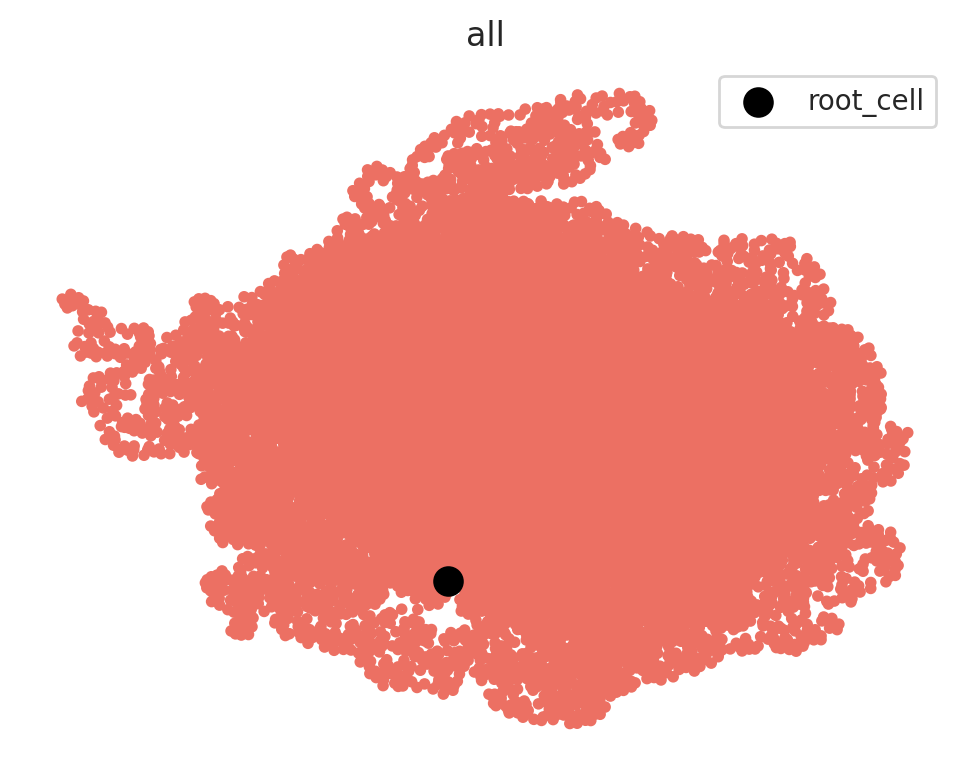

In [ ]:
pt.plot_root_cells()


In [ ]:
peaks10 = pd.read_csv("10hpf_peaks.csv", index_col=0)
peaks10 = peaks10.x.values
peaks10

array(['chr1_5232_5732', 'chr1_5787_6287', 'chr1_10088_10588', ...,
       'chr25_37499249_37499749', 'chr25_37499773_37500273',
       'chr25_37501135_37501635'], dtype=object)

In [ ]:
peaks12 = pd.read_csv("12hpf_peaks.csv", index_col=0)
peaks24 = pd.read_csv("24hpf_peaks.csv", index_col=0)
peaks12 = peaks12.x.values
peaks24 = peaks24.x.values


In [ ]:
cicero_connections10 = pd.read_csv("10hpf_cicero_connections.csv", index_col=0)
cicero_connections10.head()

,Peak1,Peak2,coaccess
Unnamed: 0,,,
1,chr1_10000521_10001021,chr1_9759387_9759887,-0.000676
2,chr1_10000521_10001021,chr1_9770122_9770622,-0.008035
3,chr1_10000521_10001021,chr1_9798566_9799066,0.006917
4,chr1_10000521_10001021,chr1_9799313_9799813,-0.000837
5,chr1_10000521_10001021,chr1_9799946_9800446,0.032700


In [ ]:
cicero_connections12 = pd.read_csv("12hpf_cicero_connections.csv", index_col=0)
cicero_connections24 = pd.read_csv("24hpf_cicero_connections.csv", index_col=0)


pandas.core.frame.DataFrame

In [ ]:
cicero_connections_combined = pd.concat([cicero_connections10, cicero_connections12, cicero_connections24], ignore_index=True)
cicero_connections_combined

,Peak1,Peak2,coaccess
0,chr1_10000521_10001021,chr1_9759387_9759887,-0.000676
1,chr1_10000521_10001021,chr1_9770122_9770622,-0.008035
2,chr1_10000521_10001021,chr1_9798566_9799066,0.006917
3,chr1_10000521_10001021,chr1_9799313_9799813,-0.000837
4,chr1_10000521_10001021,chr1_9799946_9800446,0.032700
...,...,...,...
9023797,chr1_9992216_9992716,chr1_10208891_10209391,0.000000
9023798,chr1_9992216_9992716,chr1_10211692_10212192,0.000000
9023799,chr1_9992216_9992716,chr1_10223049_10223549,-0.000009
9023800,chr1_9992216_9992716,chr1_10232696_10233196,0.000000


In [ ]:

peaks_combined = np.concatenate((peaks10, peaks12, peaks24))
peaks_combined


array(['chr1_5232_5732', 'chr1_5787_6287', 'chr1_10088_10588', ...,
       'chr25_37499249_37499749', 'chr25_37499773_37500273',
       'chr25_37501135_37501635'], dtype=object)

In [ ]:
tss_annotated = ma.get_tss_info(peak_str_list=peaks_combined, ref_genome="danRer11")

# Check results
tss_annotated.tail()

que bed peaks: 1110174
tss peaks in que: 53223


,chr,start,end,gene_short_name,strand
53218,chr13,31377025,31377525,ubtd1a,-
53219,chr13,31377955,31378455,ubtd1a,-
53220,chr6,42289926,42290426,tex264a,-
53221,chr6,42289926,42290426,tex264a,-
53222,chr6,42289926,42290426,tex264a,-


In [ ]:
integrated = ma.integrate_tss_peak_with_cicero(tss_peak=tss_annotated,
                                               cicero_connections=cicero_connections_combined)
print(integrated.shape)
integrated.head()

(111854, 3)


,peak_id,gene_short_name,coaccess
0,chr10_10312253_10312753,urm1,1.0
1,chr10_10312763_10313263,urm1,1.0
2,chr10_10330414_10330914,mir219-1,1.0
3,chr10_10385951_10386451,sardh,1.0
4,chr10_10728697_10729197,swi5,1.0


In [ ]:
peak = integrated[integrated.coaccess >= 0.8]
peak = peak[["peak_id", "gene_short_name"]].reset_index(drop=True)

In [ ]:
import celloracle as co
from celloracle import motif_analysis as ma
from celloracle.utility import save_as_pickled_object
import genomepy
genomepy.install_genome(name="danRer11", provider="UCSC")

19:41:33 | INFO | Downloading assembly summaries from UCSC
19:41:35 | INFO | Downloading genome from UCSC. Target URL: https://hgdownload.soe.ucsc.edu/goldenPath/danRer11/bigZips/danRer11.fa.gz...


Download:   0%|          | 0.00/518M [00:00<?, ?B/s]

19:41:42 | INFO | Genome download successful, starting post processing...
19:41:53 | INFO | name: danRer11
19:41:53 | INFO | local name: danRer11
19:41:53 | INFO | fasta: /root/.local/share/genomes/danRer11/danRer11.fa


Filtering Fasta: 0.00 lines [00:00, ? lines/s]

Fasta("/root/.local/share/genomes/danRer11/danRer11.fa")

In [ ]:
ref_genome = "danRer11"

genome_installation = ma.is_genome_installed(ref_genome=ref_genome,
                                             genomes_dir=None)
print(ref_genome, "installation: ", genome_installation)

danRer11 installation:  True


In [ ]:
peaks = ma.check_peak_format(peaks, ref_genome, genomes_dir=None)


Peaks before filtering:  17687
Peaks with invalid chr_name:  0
Peaks with invalid length:  0
Peaks after filtering:  17687


In [ ]:
from gimmemotifs.motif import read_motifs
path_pfm = "CisBP_ver2_Danio_rerio.pfm"
path_motif2factors = "CisBP_ver2_Danio_rerio.motif2factors.txt"

# Check path for pfm file
print(path_pfm)

# Read motifs
motifs = read_motifs(path_pfm)

# Check first 10 motifs
motifs[:10]

/content/drive/MyDrive/celloracle/CisBP_ver2_Danio_rerio.pfm


[M00008_2.00_nnnAAww,
 M00045_2.00_GTAAACAA,
 M00056_2.00_TAATAAAT,
 M00066_2.00_nsGTTGCyAn,
 M00070_2.00_nrAACAATAnn,
 M00111_2.00_nGCCynnGGs,
 M00112_2.00_CCTsrGGCnA,
 M00113_2.00_nsCCnnAGGs,
 M00114_2.00_nnGCCynnGG,
 M00115_2.00_nnATnAAAn]

In [ ]:
tfi = ma.TFinfo(peak_data_frame=peaks,
                ref_genome=ref_genome,
                genomes_dir=None)

In [ ]:
tfi.scan(fpr=0.02,
         motifs=motifs,  # If you enter None, default motifs will be loaded.
         verbose=True)

Checking your motifs... Motifs format looks good. 

Initiating scanner... 



DEBUG:gimme.scanner:using background: genome danRer11 with size 200


Calculating FPR-based threshold. This step may take substantial time when you load a new ref-genome. It will be done quicker on the second time. 



DEBUG:gimme.scanner:determining FPR-based threshold


Motif scan started .. It may take long time.



Scanning:   0%|          | 0/17203 [00:00<?, ? sequences/s]

In [ ]:
tfi.to_hdf5(file_path="results.celloracle.tfinfo")


In [ ]:
# Reset filtering
tfi.reset_filtering()

# Do filtering
tfi.filter_motifs_by_score(threshold=10)

# Format post-filtering results.
tfi.make_TFinfo_dataframe_and_dictionary(verbose=True)

Filtering finished: 6224755 -> 1365217
1. Converting scanned results into one-hot encoded dataframe.


  0%|          | 0/17203 [00:00<?, ?it/s]

2. Converting results into dictionaries.


  0%|          | 0/12802 [00:00<?, ?it/s]

  0%|          | 0/867 [00:00<?, ?it/s]

In [ ]:
df = tfi.to_dataframe()
df.head()

,peak_id,gene_short_name,A6H8I1_DANRE,CABZ01017151.1,CABZ01056727.1,CABZ01057488.2,CABZ01066696.1,CABZ01067175.1,CABZ01079847.1,CABZ01081359.1,...,znf143b,znf148,znf281a,znf281b,znf652,znf653,znf711,znf740b,znf76,zzz3
0,chr10_10312253_10312753,urm1,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,chr10_10312763_10313263,urm1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,chr10_10330414_10330914,mir219-1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,chr10_10385951_10386451,sardh,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,chr10_10728697_10729197,swi5,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Save result as a dataframe
df = tfi.to_dataframe()
df.to_parquet("base_GRN_dataframe.parquet")

In [ ]:
# visualization settings
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

plt.rcParams['figure.figsize'] = [6, 4.5]
plt.rcParams["savefig.dpi"] = 300
save_folder = "figures"
os.makedirs(save_folder, exist_ok=True)

In [ ]:
import pandas as pd

# Assuming 'adata' is your AnnData object
# Define abbreviations for the cell types
abbreviations = {
    'central_nervous_system': 'CNS',
    'endoderm': 'END',
    'hematopoietic_system': 'HEM',
    'lateral_mesoderm': 'LAT',
    'mesenchyme': 'MES',
    'notochord': 'NOT',
    'paraxial_mesoderm': 'PAR',
    'periderm': 'PER',
    'intermediate_mesoderm': 'INM',
    'neural_crest':"NRC"
}

# Apply abbreviations to zebrafish_anatomy_ontology_class
adata_rna_combined.obs['short_class'] = adata_rna_combined.obs['zebrafish_anatomy_ontology_class'].map(abbreviations)

# Ensure 'louvain_annot' is not categorical yet or convert it
adata_rna_combined.obs['louvain_annot'] = adata_rna_combined.obs['louvain'].astype(str)

# Group by the zebrafish_anatomy_ontology_class and find unique louvain clusters
grouped = adata_rna_combined.obs.groupby('zebrafish_anatomy_ontology_class')['louvain'].unique()

# Assign a unique identifier to each cluster within its class
for cell_type, clusters in grouped.items():
    for idx, cluster in enumerate(clusters, start=1):
        new_id = abbreviations[cell_type] + '_' + str(idx)
        adata_rna_combined.obs.loc[adata_rna_combined.obs['louvain'] == cluster, 'louvain_annot'] = new_id

# If you want to convert 'louvain_annot' back to categorical after assignment:
adata_rna_combined.obs['louvain_annot'] = pd.Categorical(adata_rna_combined.obs['louvain_annot'])

# Check the results
print(adata_rna_combined.obs[['louvain', 'zebrafish_anatomy_ontology_class', 'louvain_annot']].head())


                         louvain zebrafish_anatomy_ontology_class  \
cell_id                                                             
TDR36_TGATCTTGTCACTTAG-1       4                 lateral_mesoderm   
TDR35_GACTGATAGATTGTGA-1       7                paraxial_mesoderm   
TDR43_ACCCAAAAGCACGATG-1       9           central_nervous_system   
TDR36_CCGCAAGCATAACAGA-1       4                paraxial_mesoderm   
TDR46_GTTCATTGTTTGAAAG-1      34                     neural_crest   

                         louvain_annot  
cell_id                                 
TDR36_TGATCTTGTCACTTAG-1         PAR_2  
TDR35_GACTGATAGATTGTGA-1         PAR_1  
TDR43_ACCCAAAAGCACGATG-1         CNS_1  
TDR36_CCGCAAGCATAACAGA-1         PAR_2  
TDR46_GTTCATTGTTTGAAAG-1         NRC_1  


In [ ]:
n_cells_downsample = 30000
if adata_rna_combined.shape[0] > n_cells_downsample:
    # Let's dowmsample into 30K cells
    sc.pp.subsample(adata_rna_combined, n_obs=n_cells_downsample, random_state=123)

In [ ]:
oracle = co.Oracle()


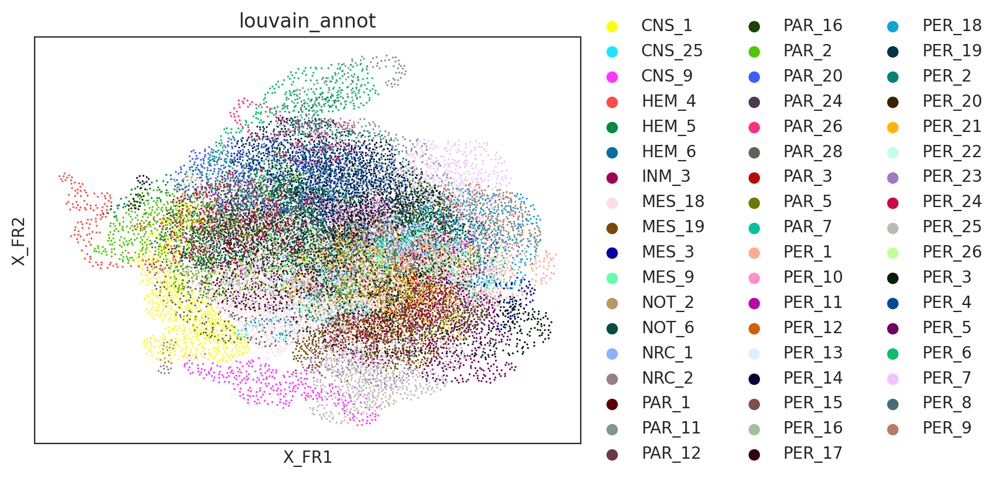

In [ ]:
adata_rna_combined.X = adata_rna_combined.layers["raw_count"].copy()

# Instantiate Oracle object.
oracle.import_anndata_as_raw_count(adata=adata_rna_combined,
                                   cluster_column_name='louvain_annot',
                                   embedding_name="X_draw_graph_fr")

In [ ]:
oracle.import_TF_data(TF_info_matrix=df)


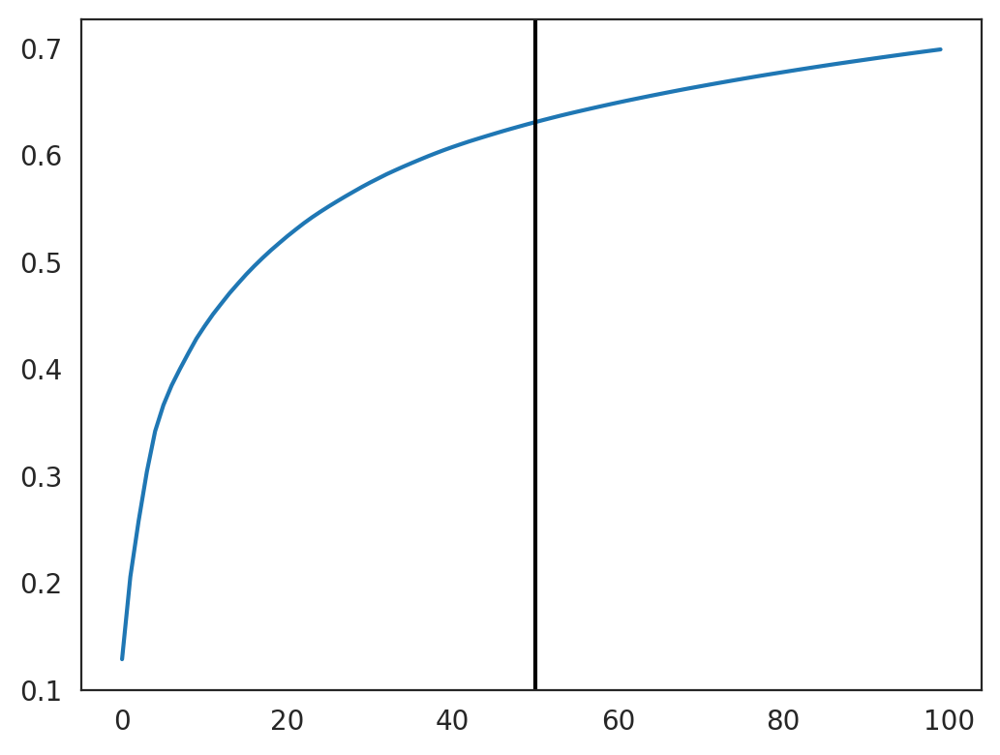

50


In [ ]:
# Perform PCA
oracle.perform_PCA()

# Select important PCs
plt.plot(np.cumsum(oracle.pca.explained_variance_ratio_)[:100])
n_comps = np.where(np.diff(np.diff(np.cumsum(oracle.pca.explained_variance_ratio_))>0.002))[0][0]
plt.axvline(n_comps, c="k")
plt.show()
print(n_comps)
n_comps = min(n_comps, 50)

In [ ]:
n_cell = oracle.adata.shape[0]
k = int(0.025*n_cell)


In [ ]:
oracle.knn_imputation(n_pca_dims=n_comps, k=k, balanced=True, b_sight=k*8,
                      b_maxl=k*4, n_jobs=4)

In [ ]:
oracle.to_hdf5(file_path="adata_rna_combined.celloracle.oracle")


In [ ]:
oracle = co.load_hdf5("adata_rna_combined.celloracle.oracle")


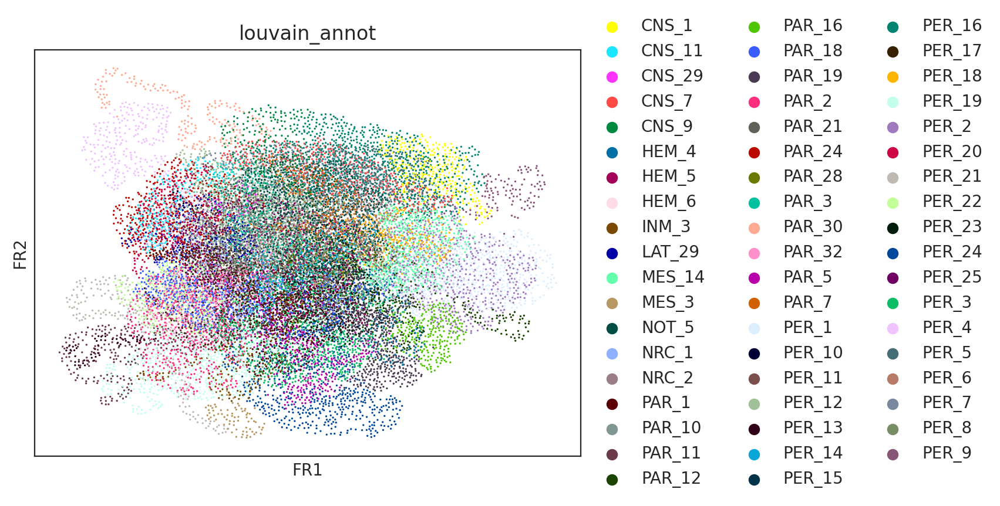

In [ ]:
sc.pl.draw_graph(oracle.adata, color="louvain_annot")


In [ ]:
links = oracle.get_links(cluster_name_for_GRN_unit="louvain_annot", alpha=10,
                         verbose_level=10)

  0%|          | 0/56 [00:00<?, ?it/s]

Inferring GRN for CNS_1...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for CNS_11...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for CNS_29...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for CNS_7...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for CNS_9...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for HEM_4...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for HEM_5...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for HEM_6...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for INM_3...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for LAT_29...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for MES_14...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for MES_3...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for NOT_5...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for NRC_1...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for NRC_2...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_1...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_10...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_11...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_12...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_16...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_18...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_19...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_2...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_21...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_24...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_28...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_3...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_30...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_32...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_5...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PAR_7...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_1...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_10...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_11...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_12...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_13...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_14...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_15...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_16...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_17...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_18...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_19...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_2...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_20...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_21...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_22...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_23...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_24...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_25...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_3...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_4...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_5...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_6...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_7...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_8...


  0%|          | 0/1352 [00:00<?, ?it/s]

Inferring GRN for PER_9...


  0%|          | 0/1352 [00:00<?, ?it/s]

In [ ]:
links.links_dict.keys()


dict_keys(['CNS_1', 'CNS_11', 'CNS_29', 'CNS_7', 'CNS_9', 'HEM_4', 'HEM_5', 'HEM_6', 'INM_3', 'LAT_29', 'MES_14', 'MES_3', 'NOT_5', 'NRC_1', 'NRC_2', 'PAR_1', 'PAR_10', 'PAR_11', 'PAR_12', 'PAR_16', 'PAR_18', 'PAR_19', 'PAR_2', 'PAR_21', 'PAR_24', 'PAR_28', 'PAR_3', 'PAR_30', 'PAR_32', 'PAR_5', 'PAR_7', 'PER_1', 'PER_10', 'PER_11', 'PER_12', 'PER_13', 'PER_14', 'PER_15', 'PER_16', 'PER_17', 'PER_18', 'PER_19', 'PER_2', 'PER_20', 'PER_21', 'PER_22', 'PER_23', 'PER_24', 'PER_25', 'PER_3', 'PER_4', 'PER_5', 'PER_6', 'PER_7', 'PER_8', 'PER_9'])

In [ ]:
links.filter_links(p=0.001, weight="coef_abs", threshold_number=2000)


In [ ]:
plt.rcParams["figure.figsize"] = [9, 4.5]

CNS_1


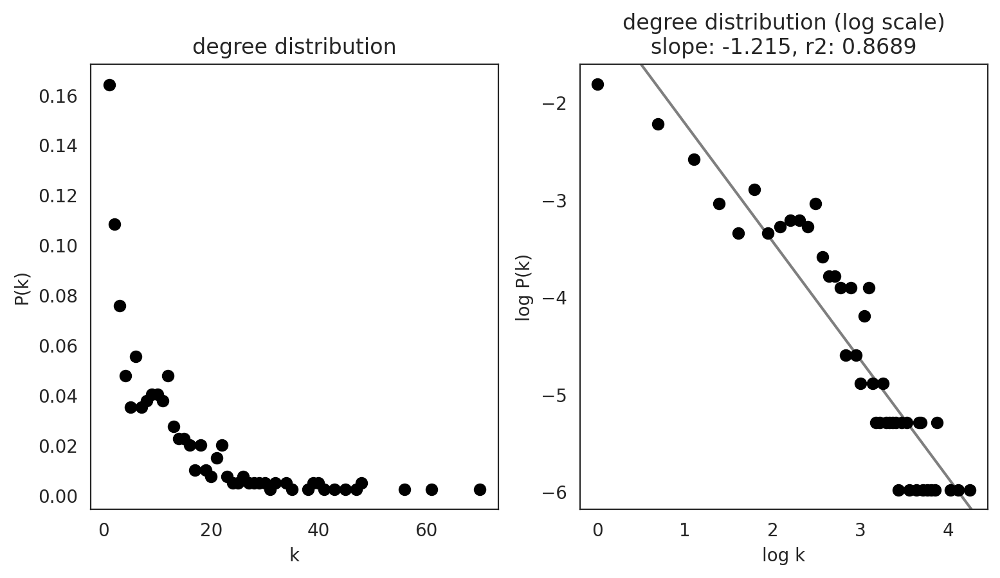

CNS_11


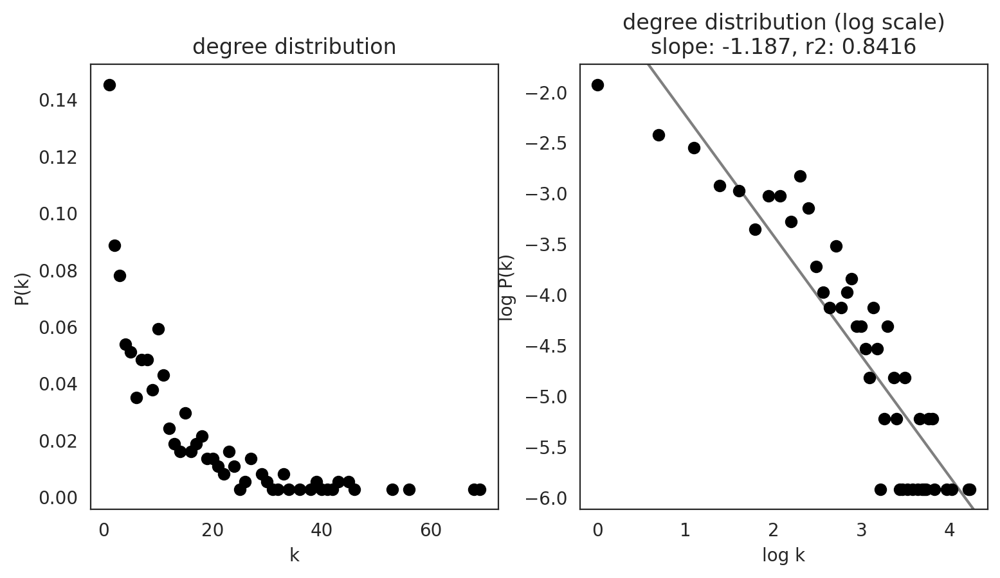

CNS_29


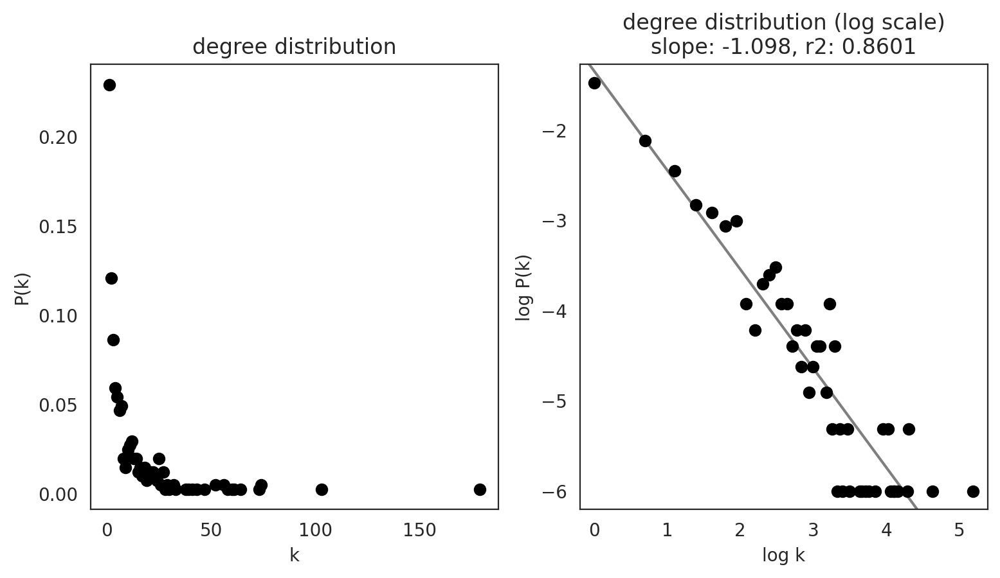

CNS_7


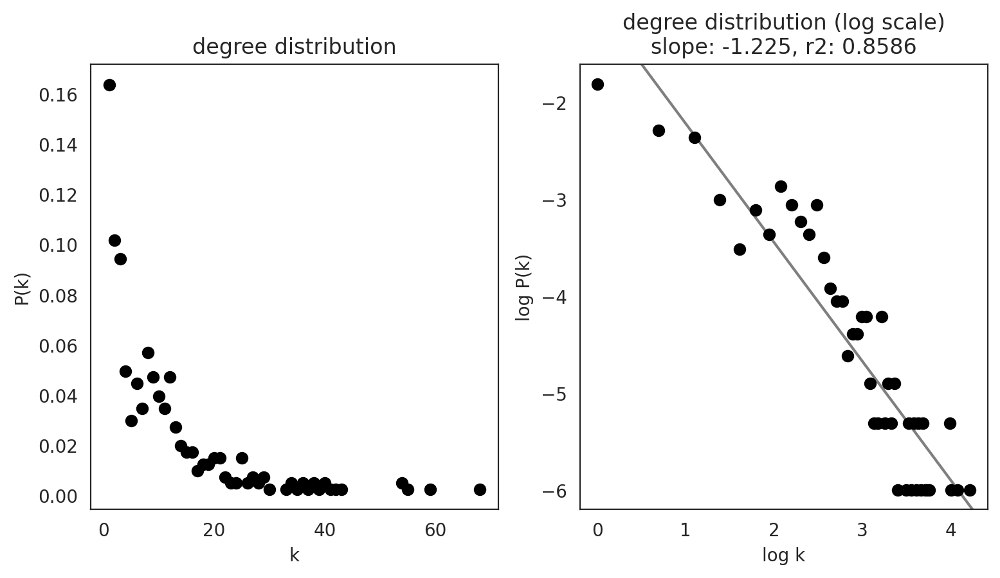

CNS_9


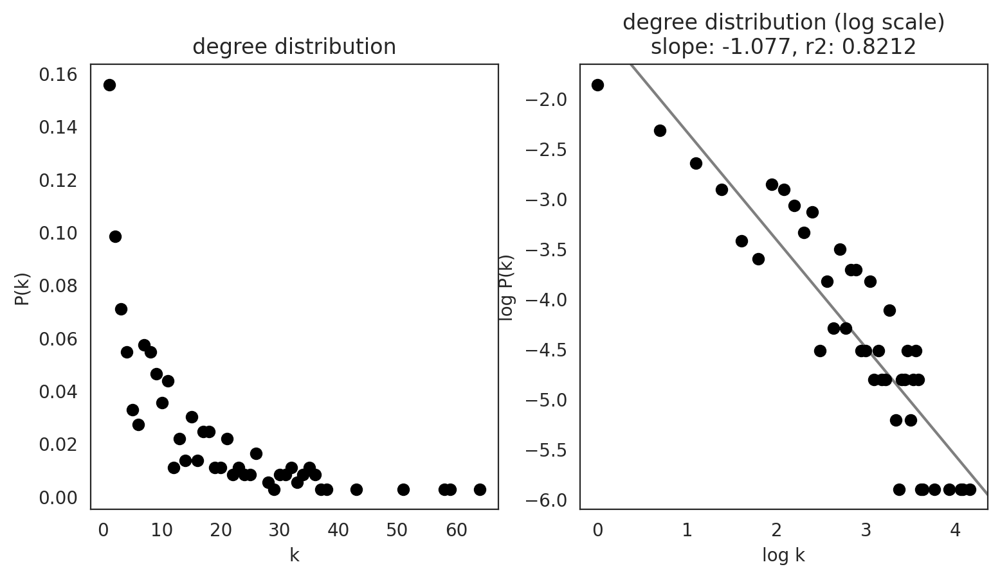

HEM_4


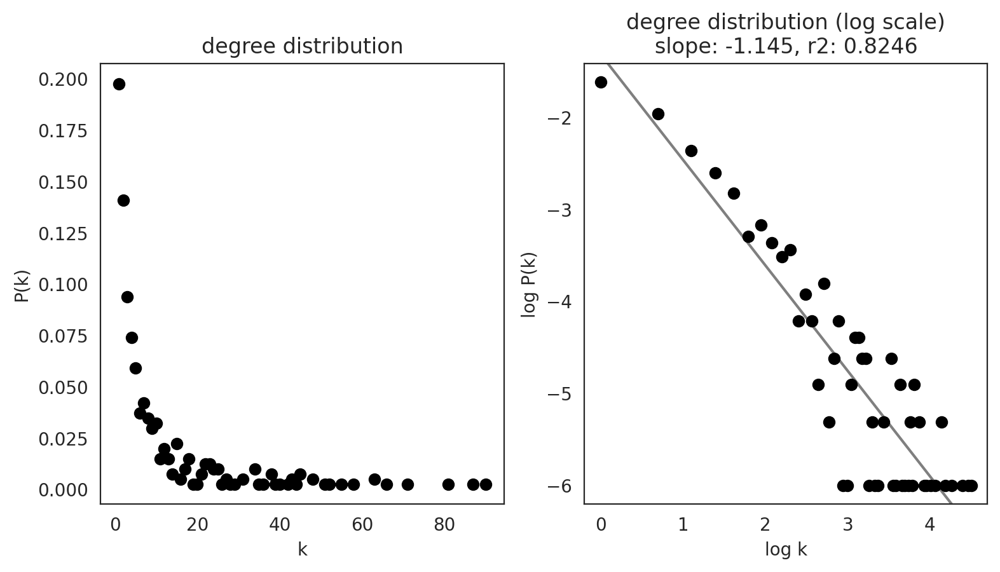

HEM_5


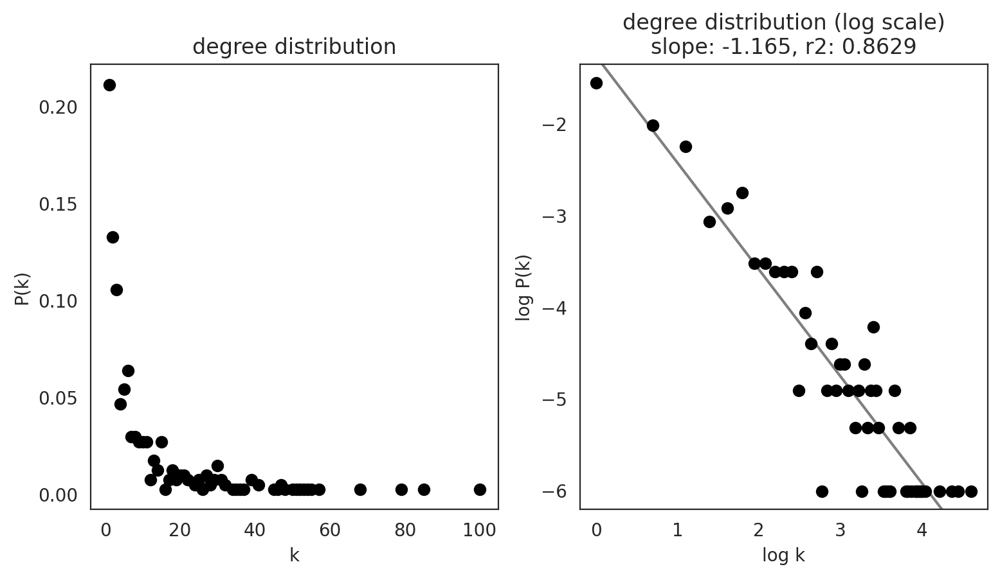

HEM_6


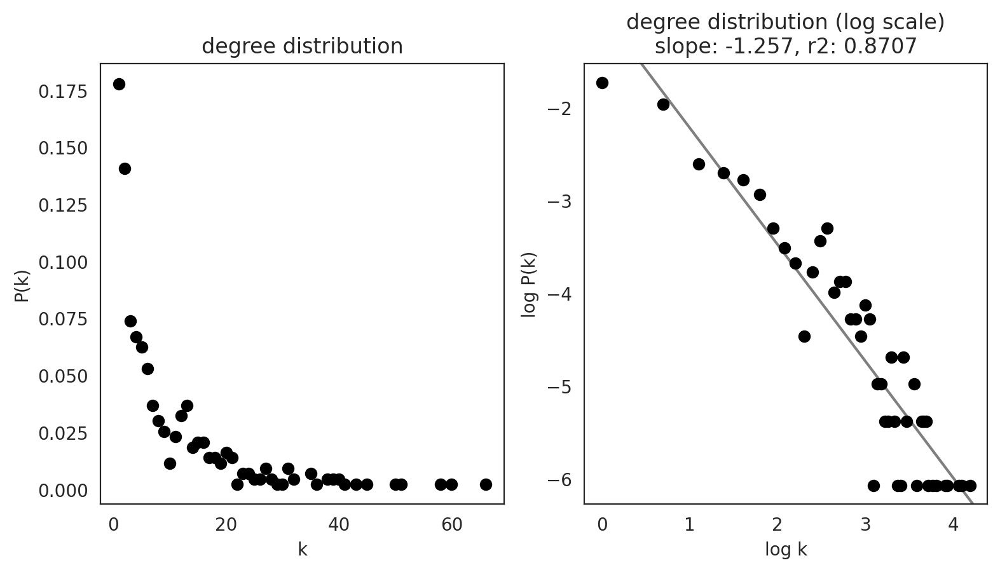

INM_3


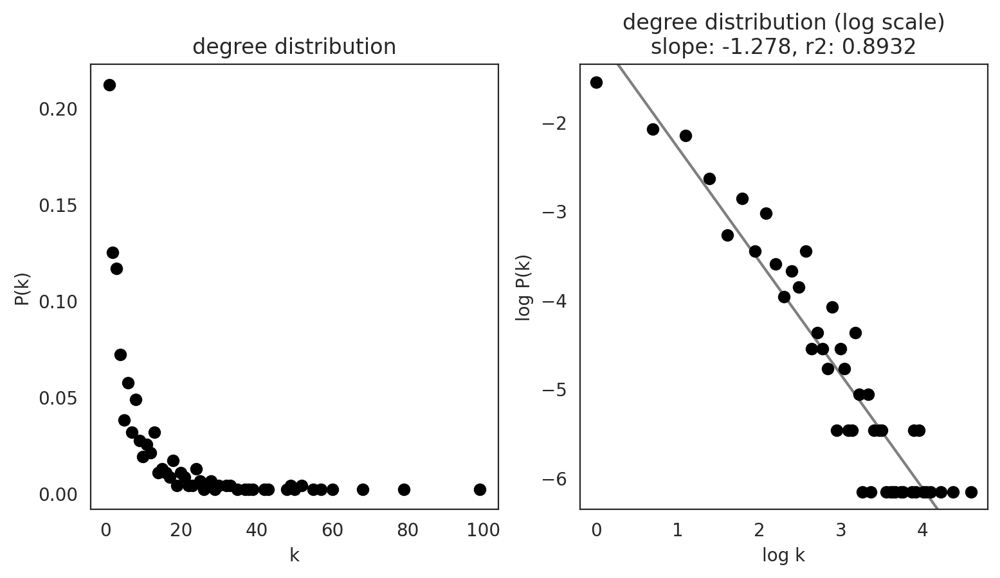

LAT_29


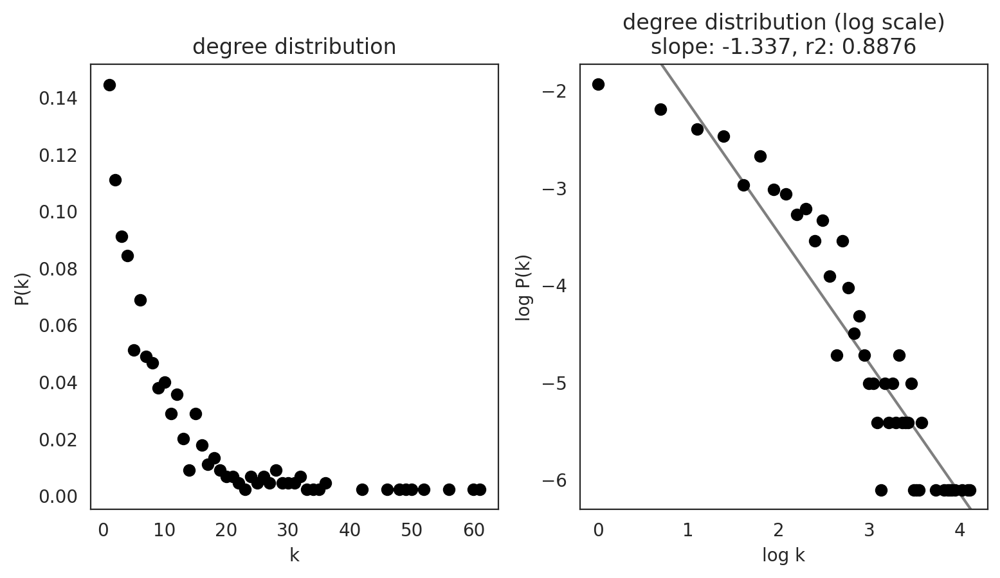

MES_14


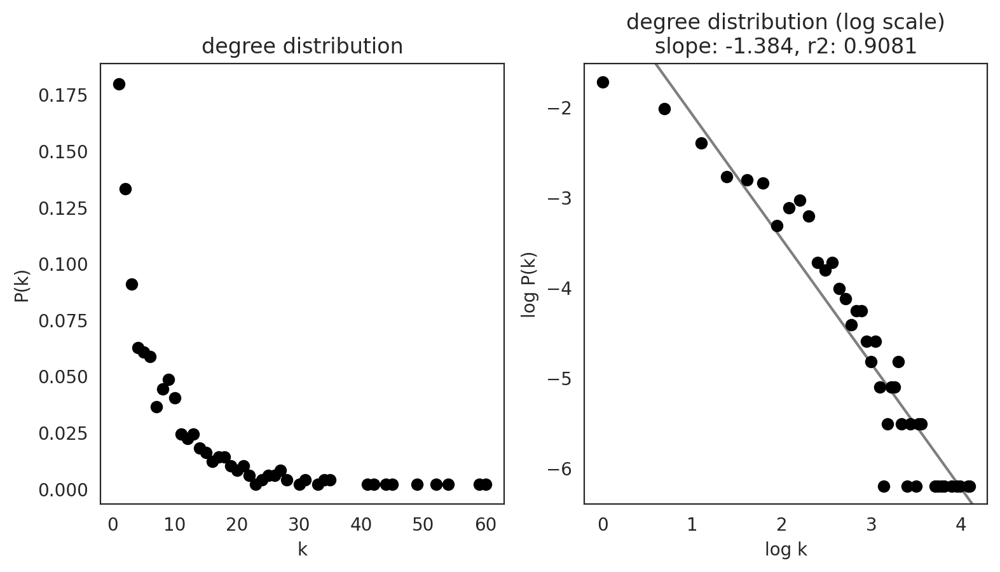

MES_3


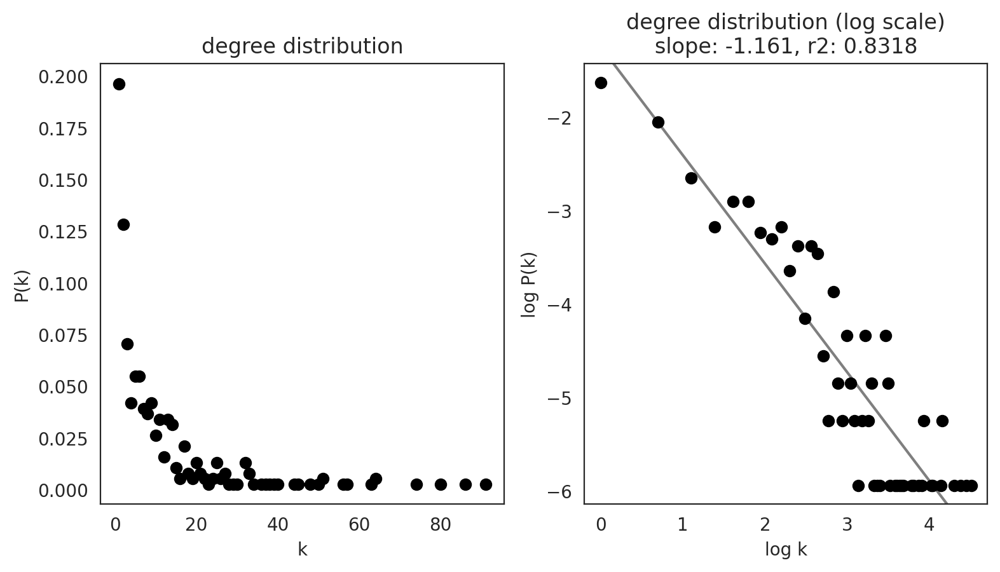

NOT_5


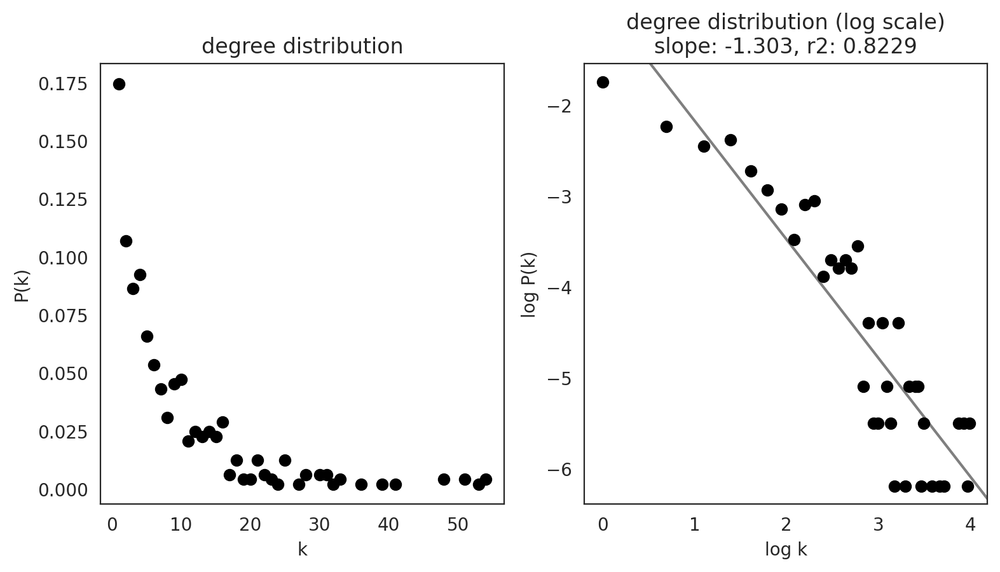

NRC_1


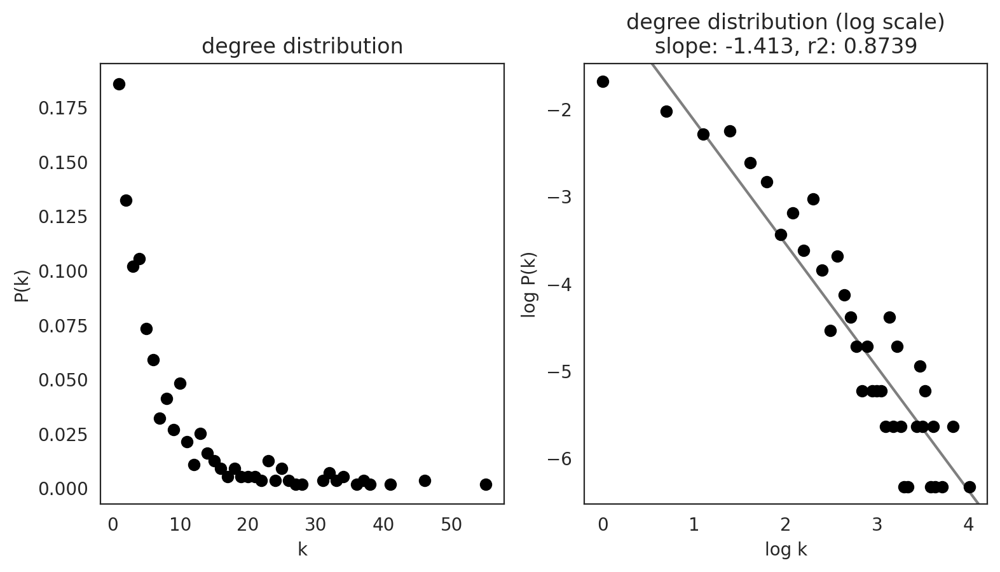

NRC_2


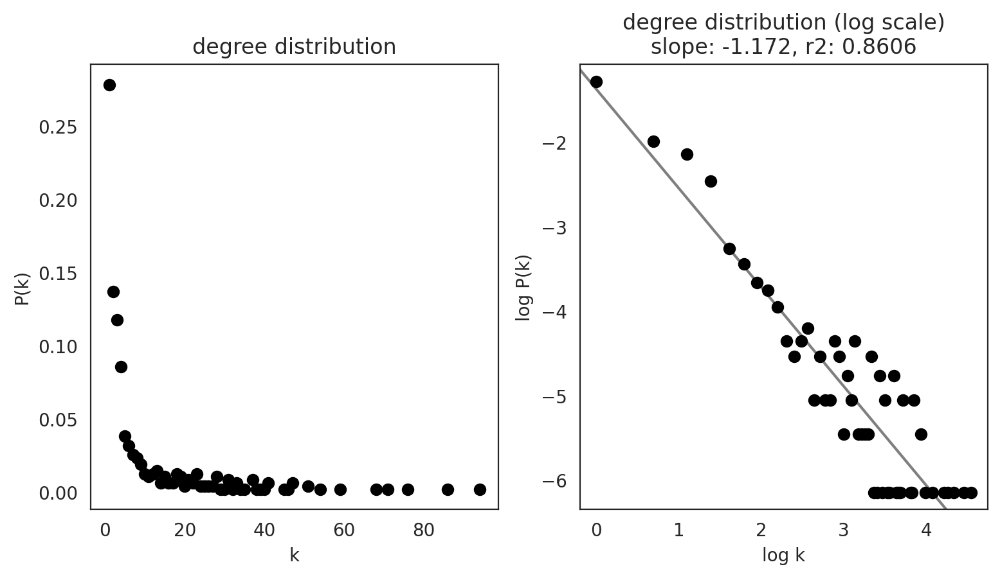

PAR_1


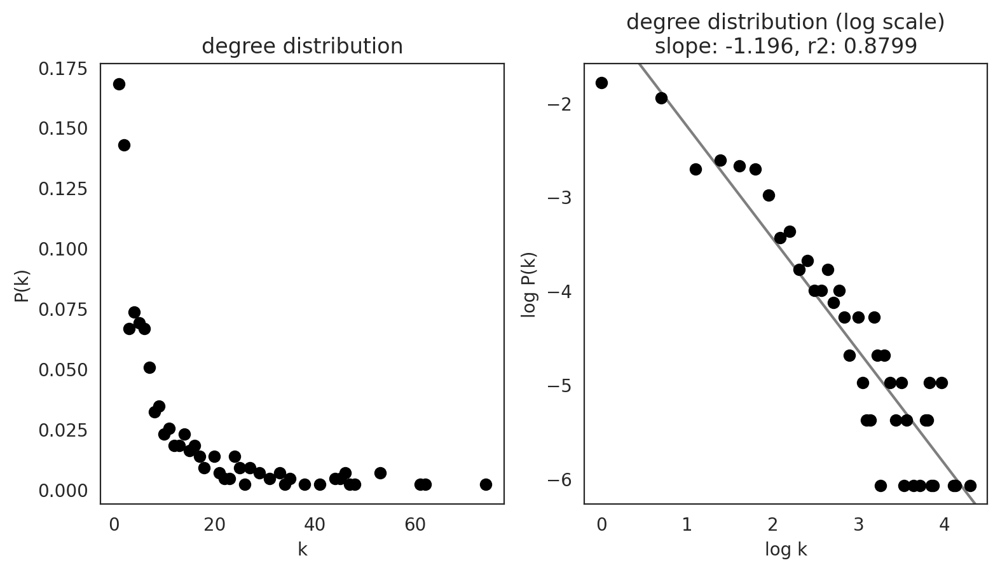

PAR_10


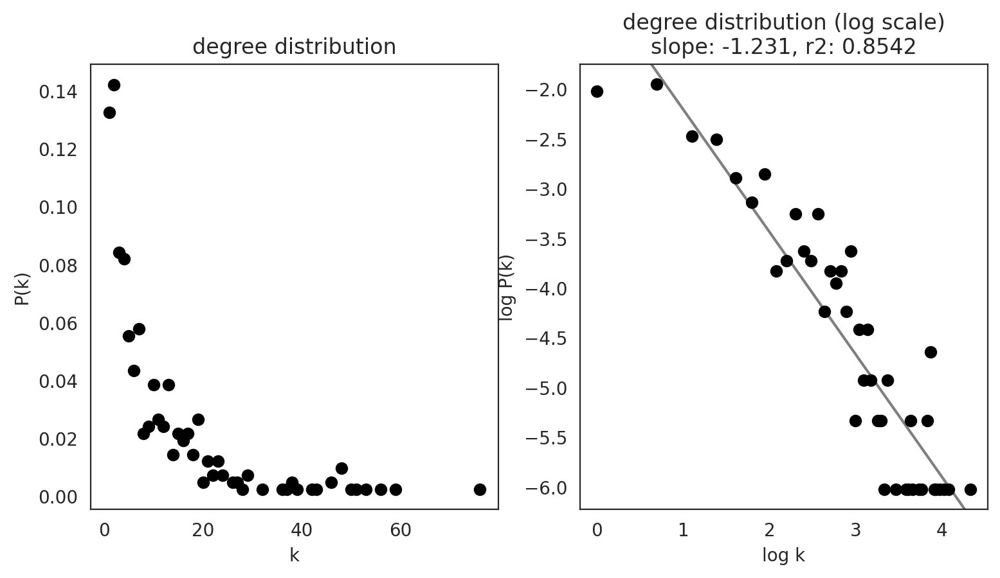

PAR_11


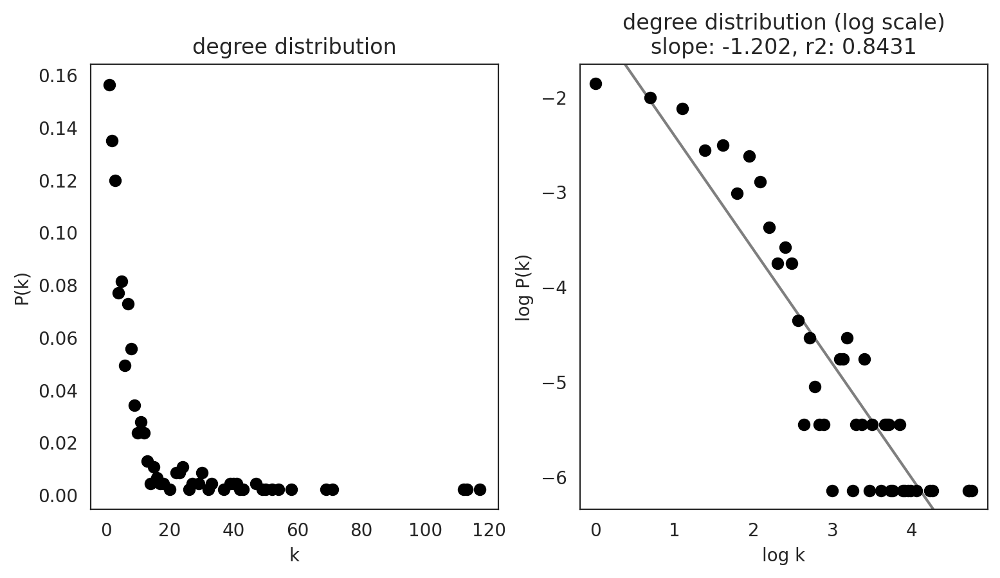

PAR_12


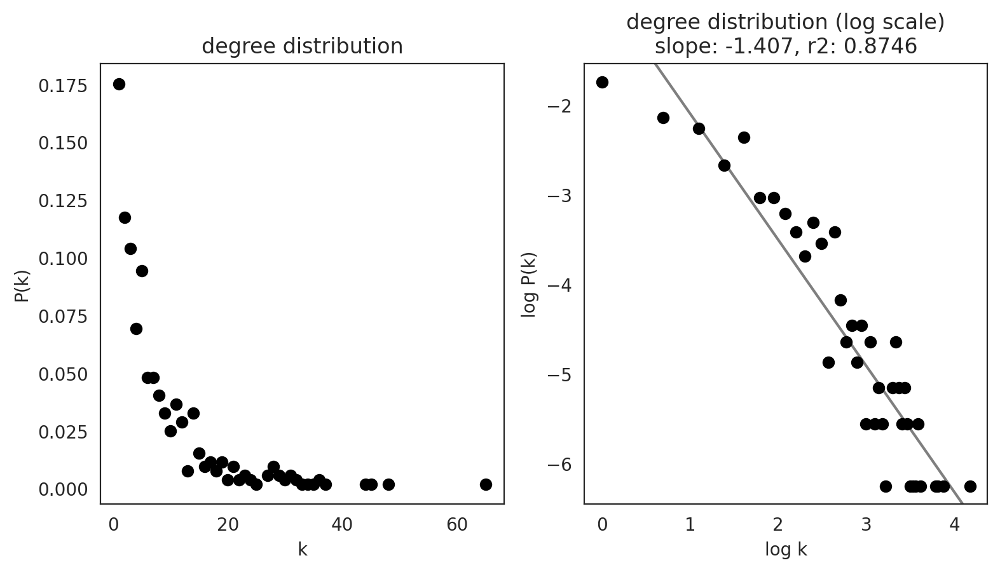

PAR_16


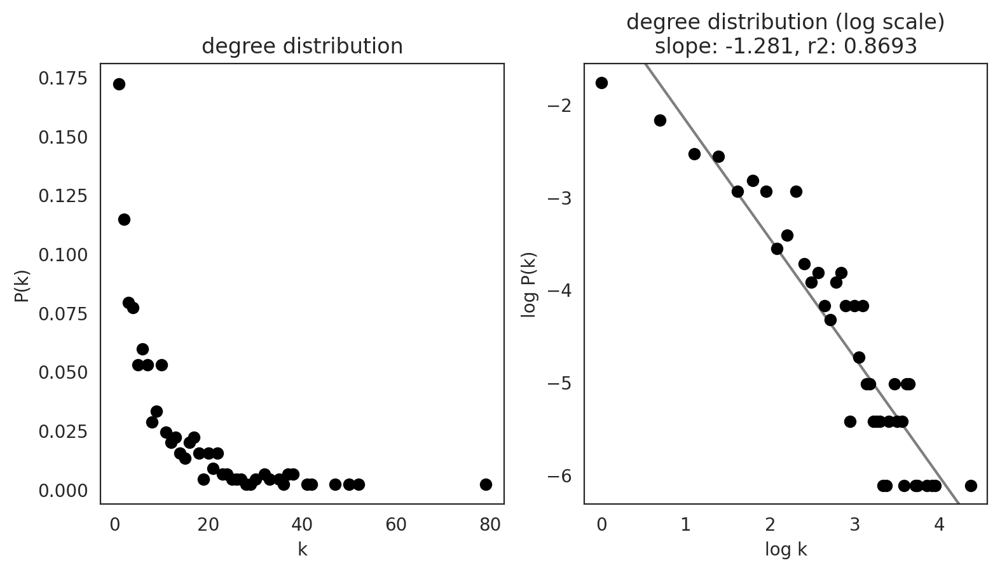

PAR_18


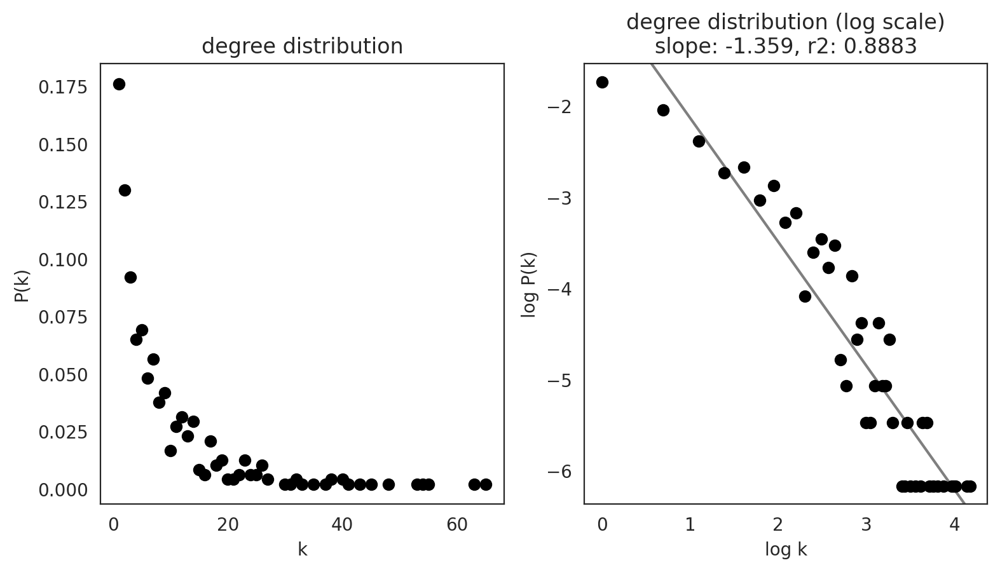

PAR_19


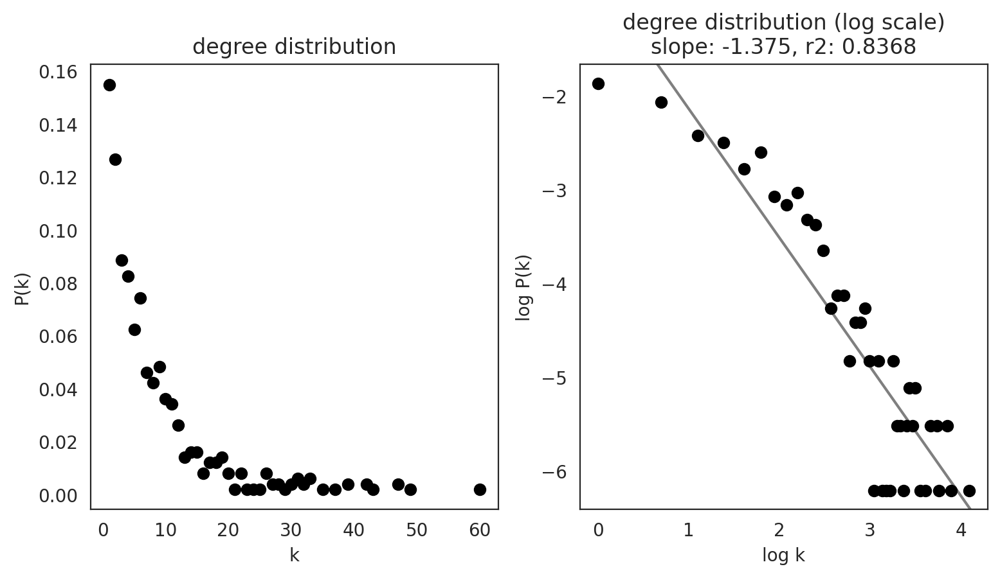

PAR_2


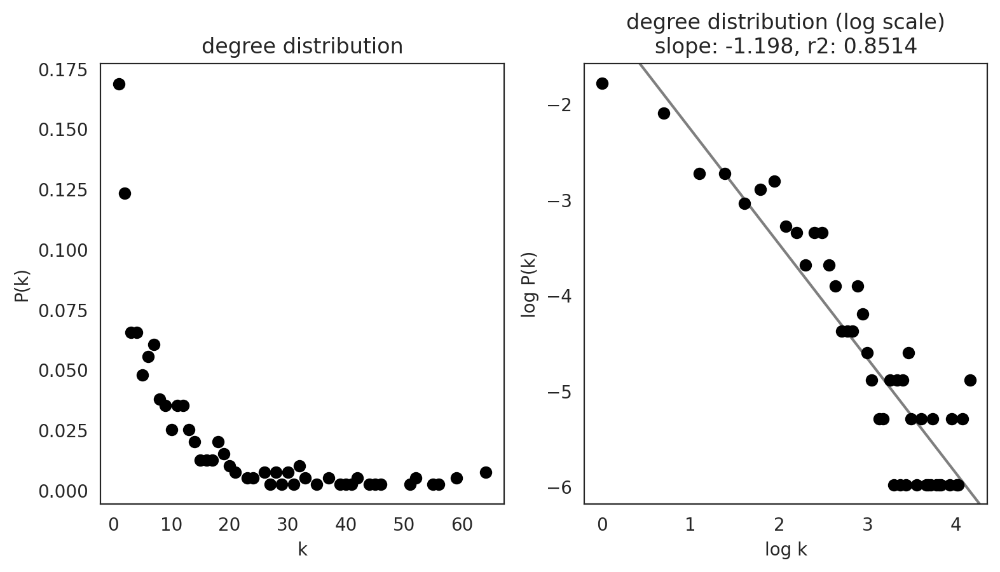

PAR_21


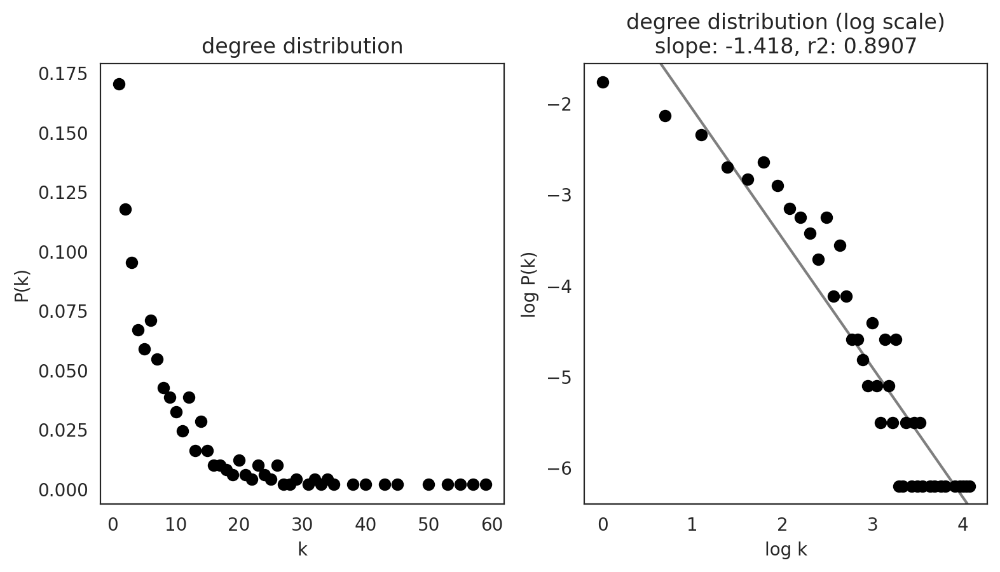

PAR_24


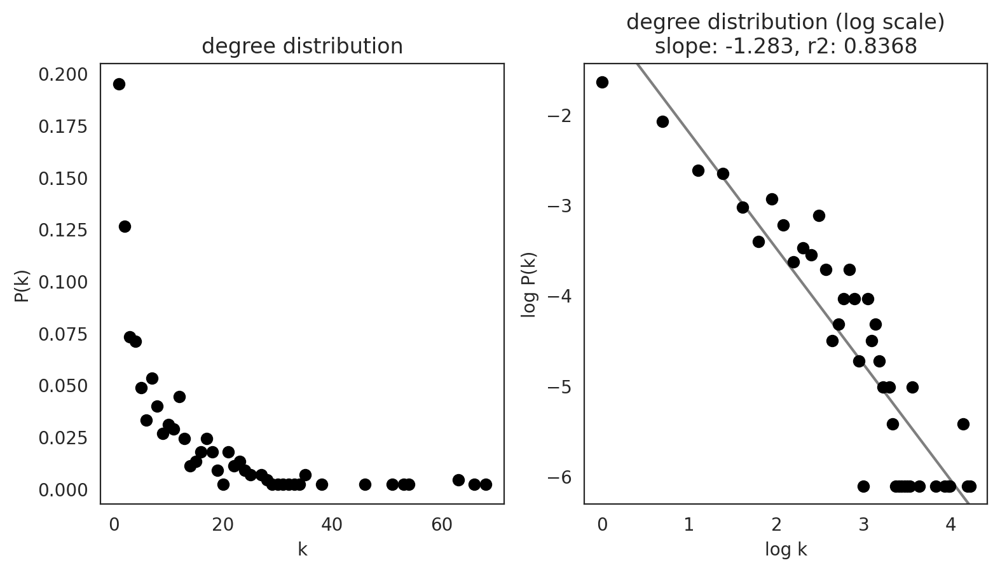

PAR_28


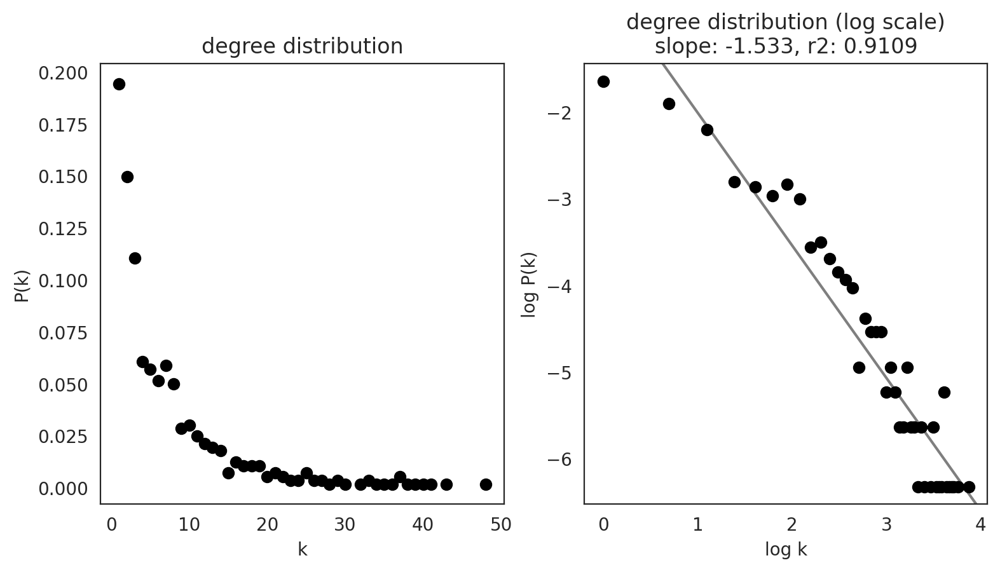

PAR_3


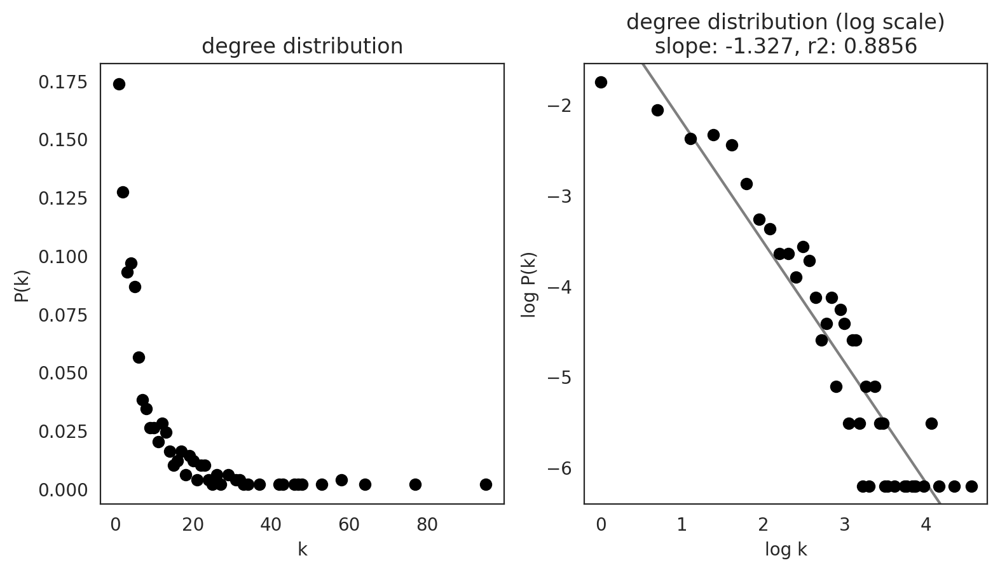

PAR_30


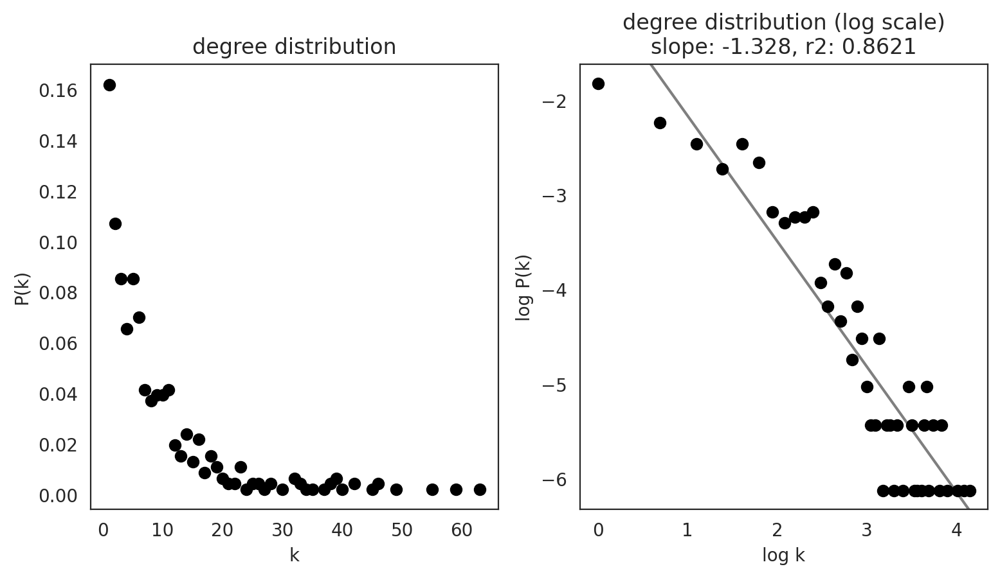

PAR_32


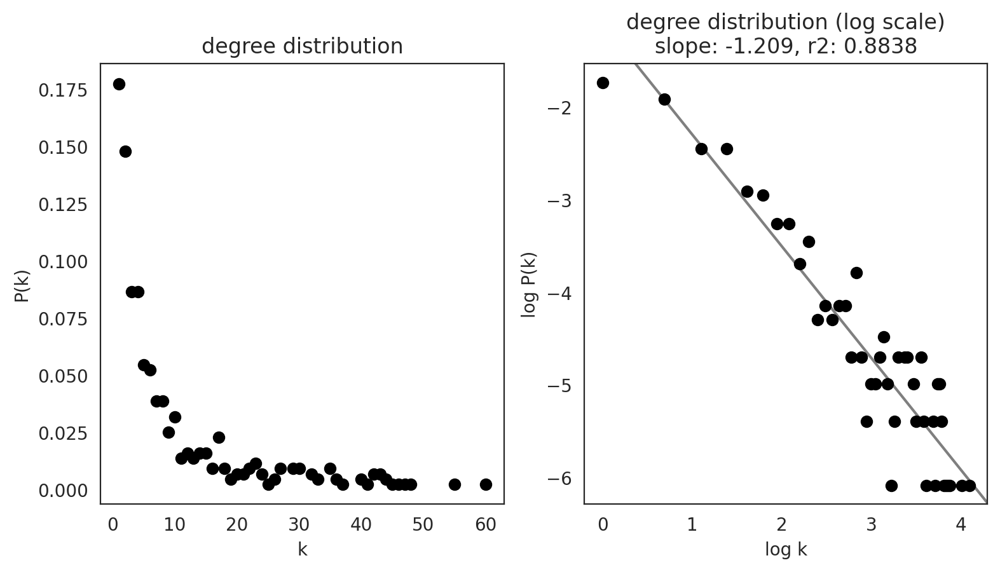

PAR_5


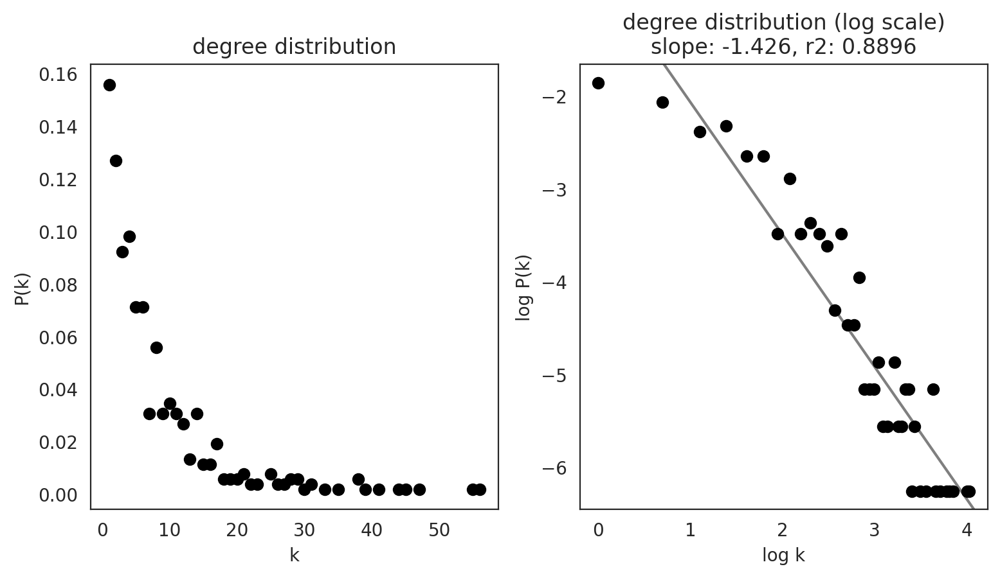

PAR_7


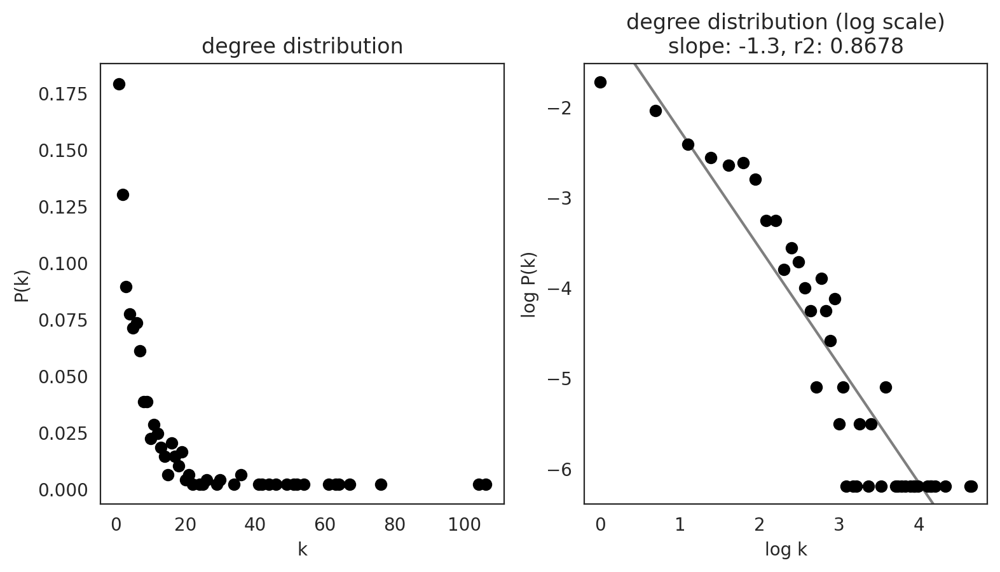

PER_1


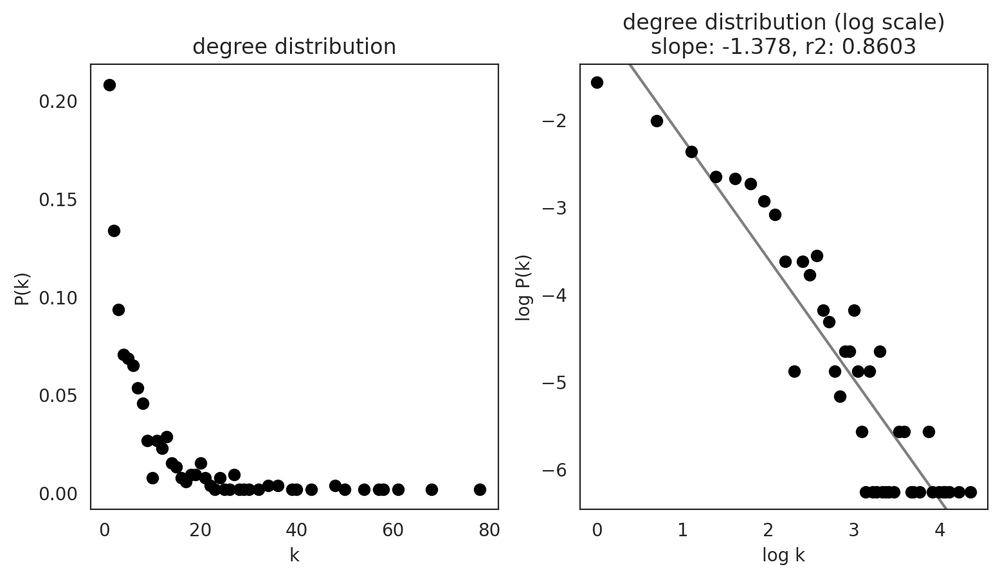

PER_10


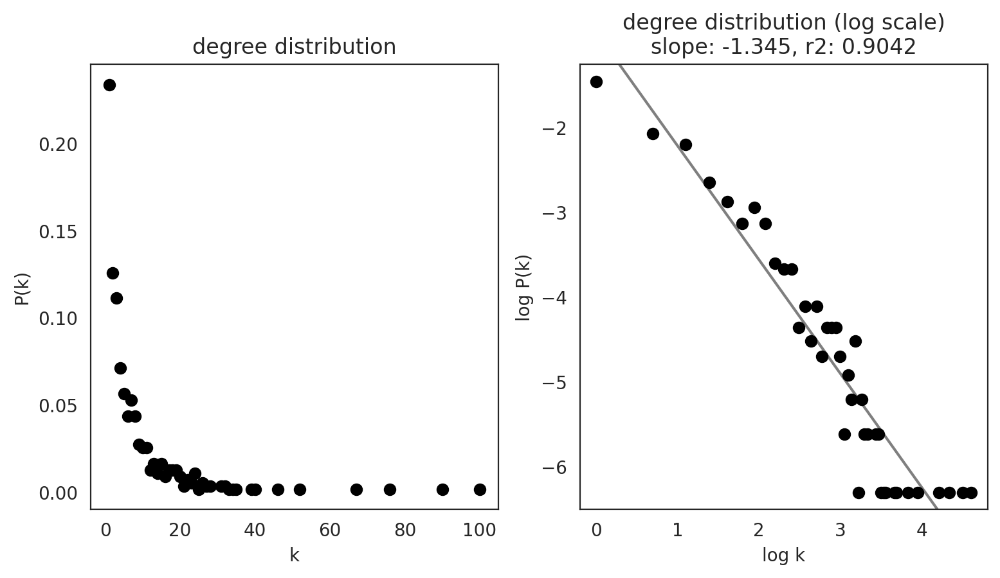

PER_11


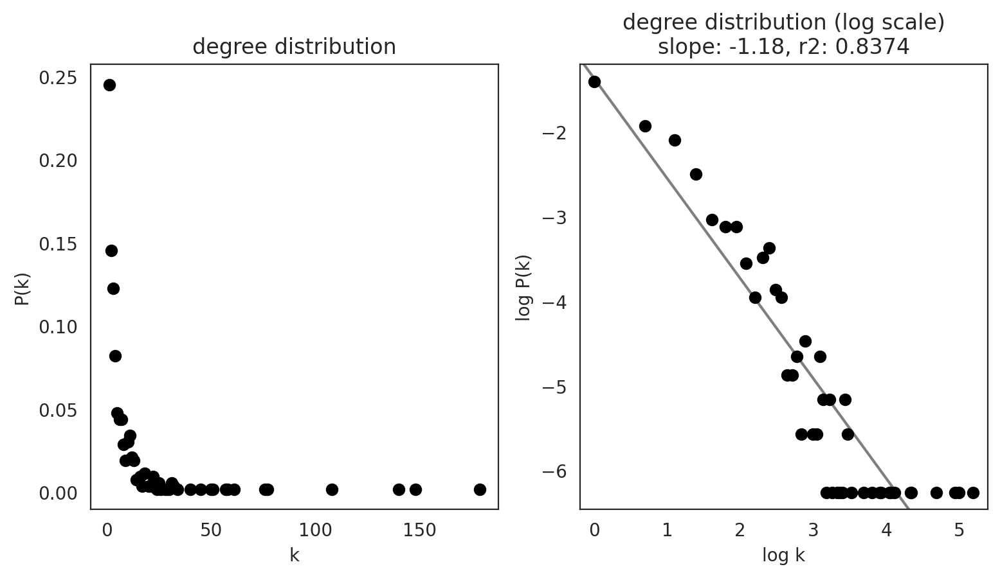

PER_12


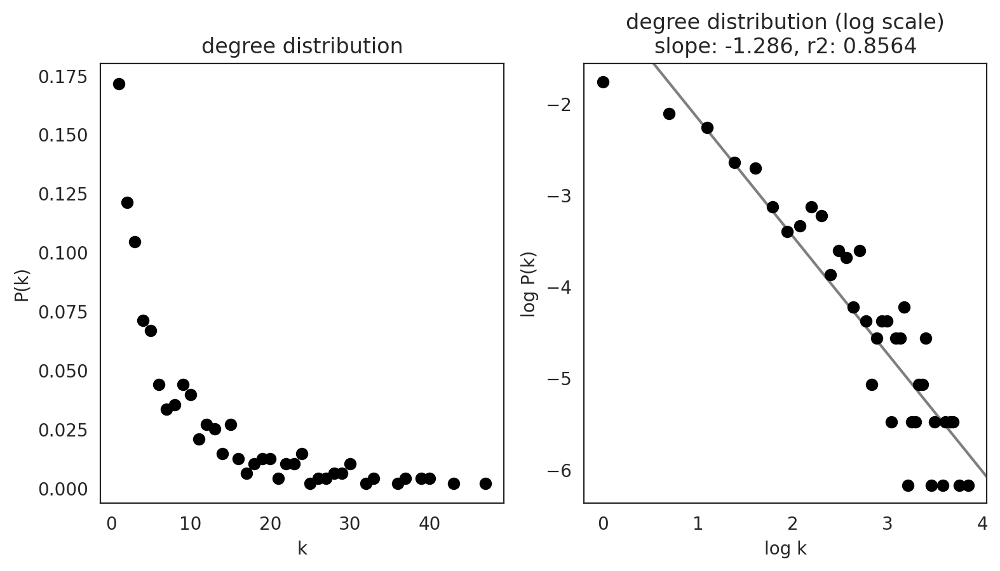

PER_13


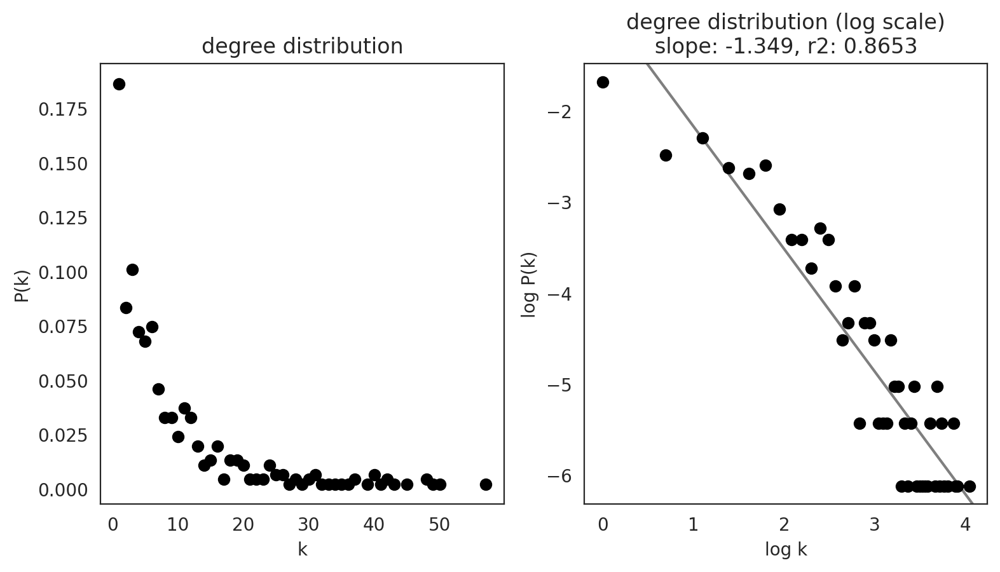

PER_14


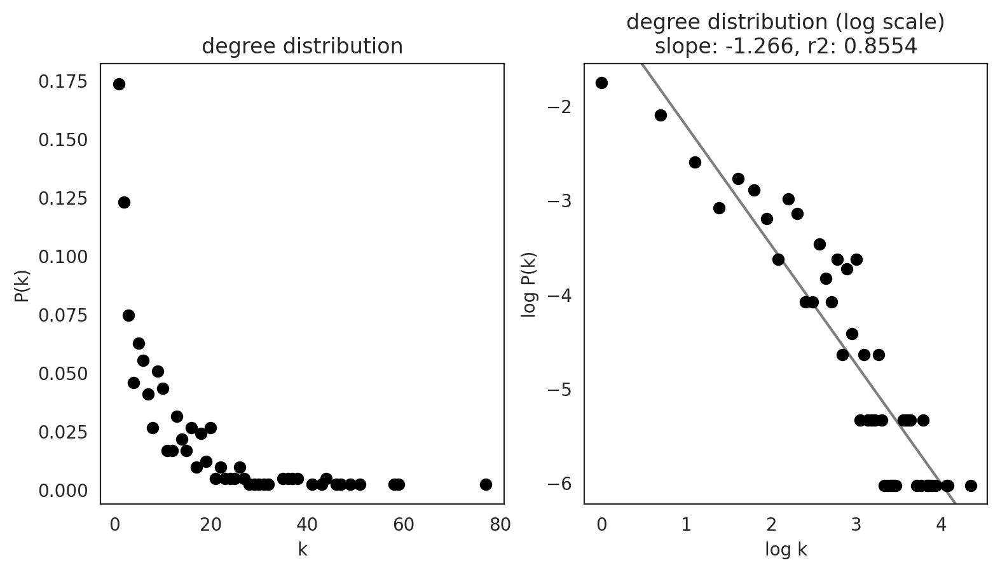

PER_15


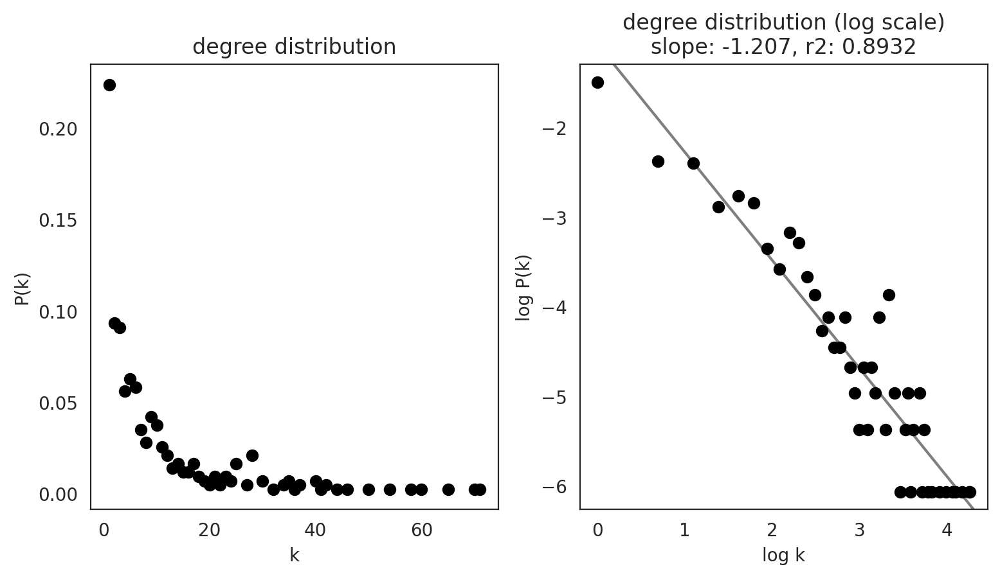

PER_16


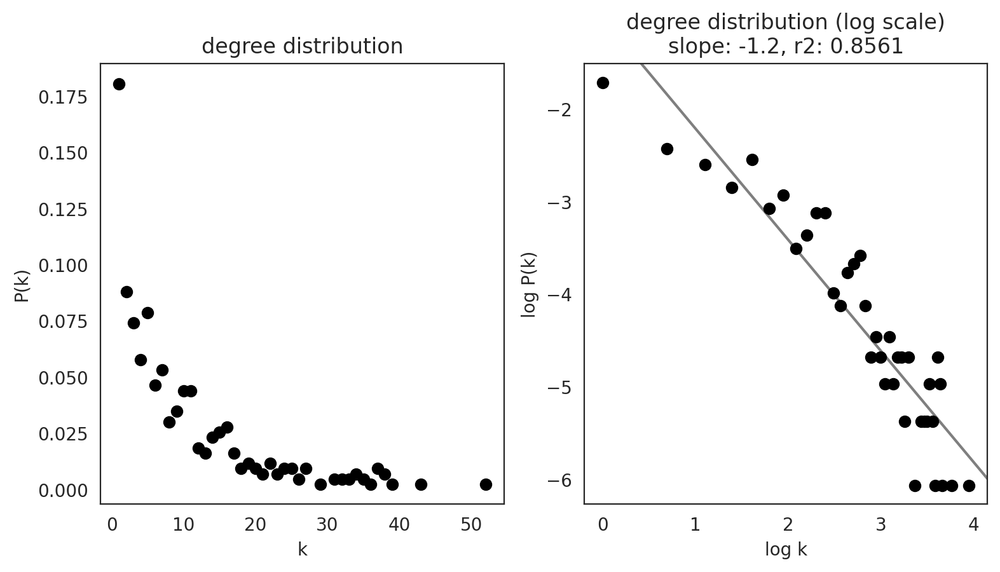

PER_17


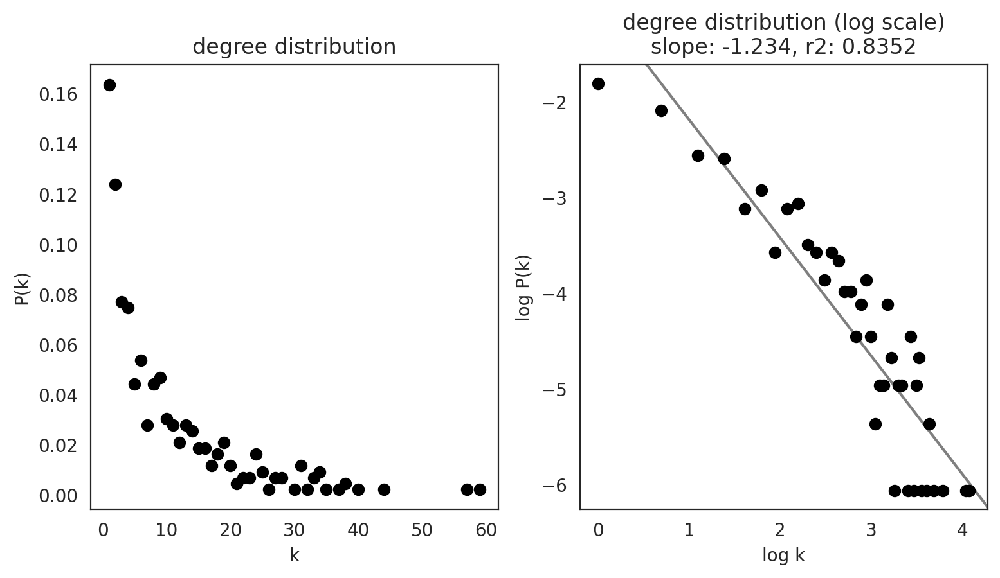

PER_18


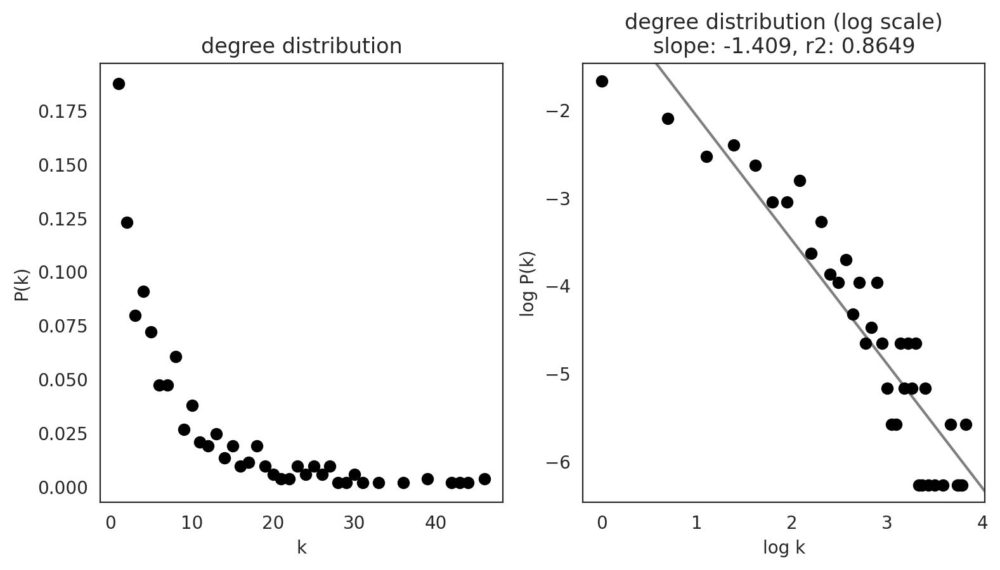

PER_19


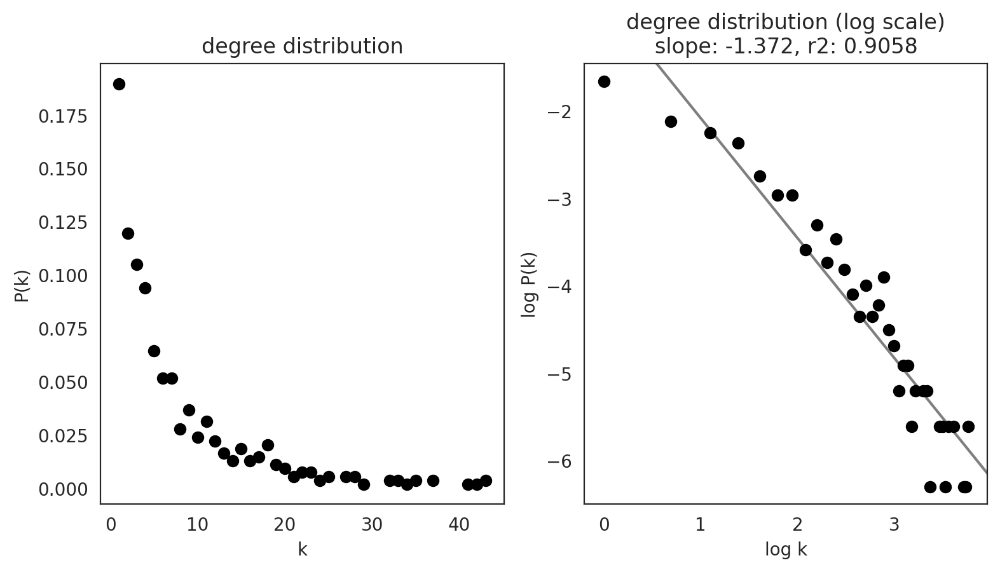

PER_2


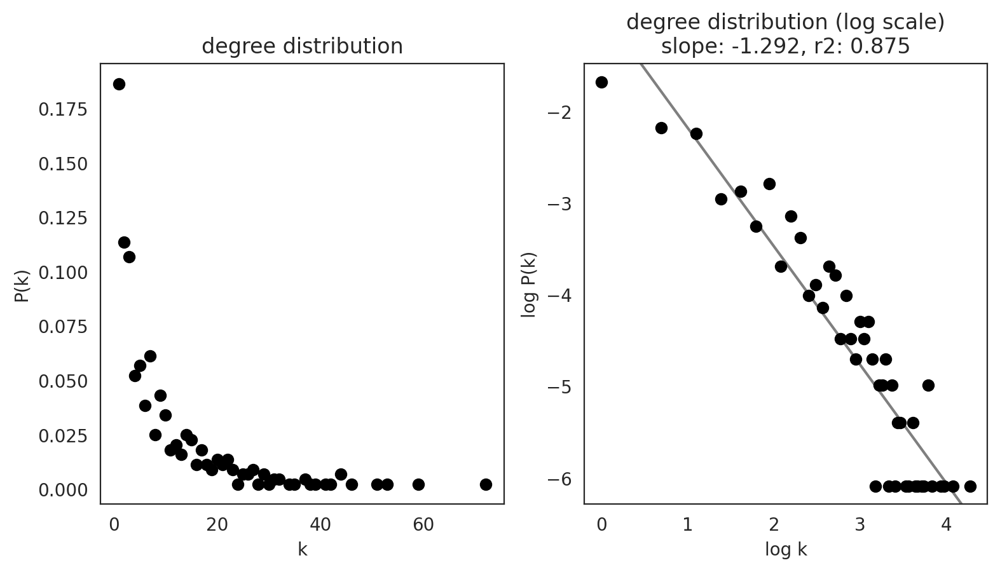

PER_20


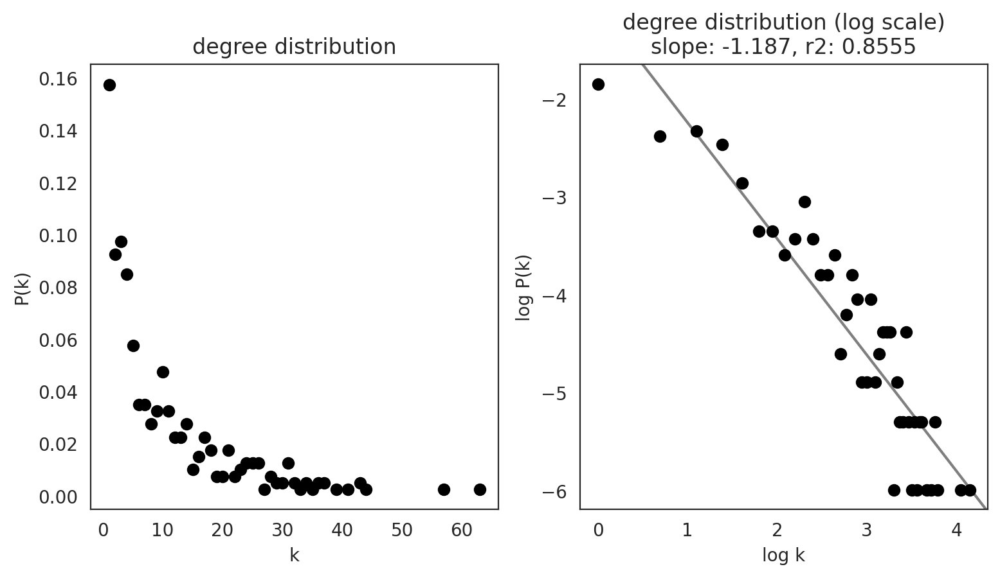

PER_21


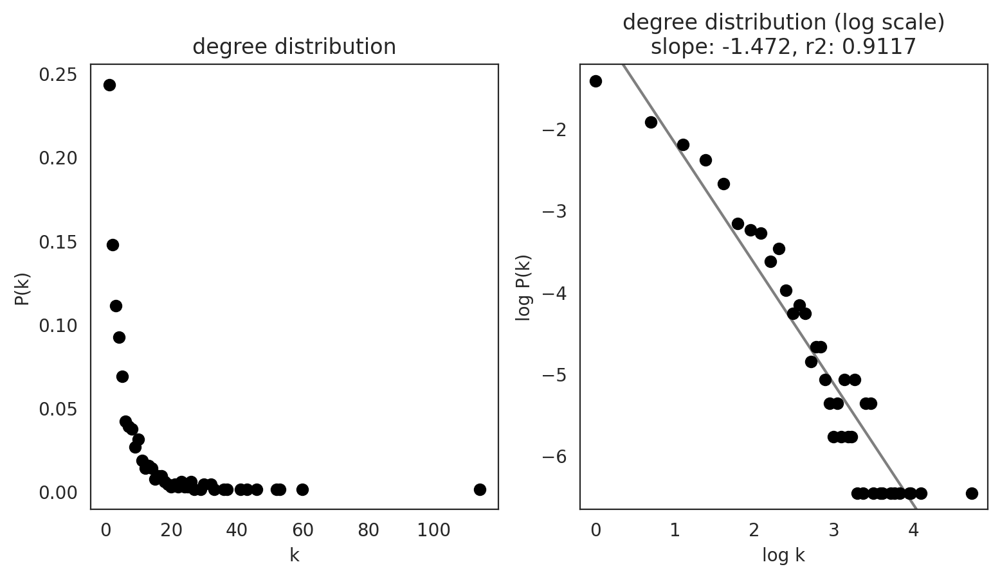

PER_22


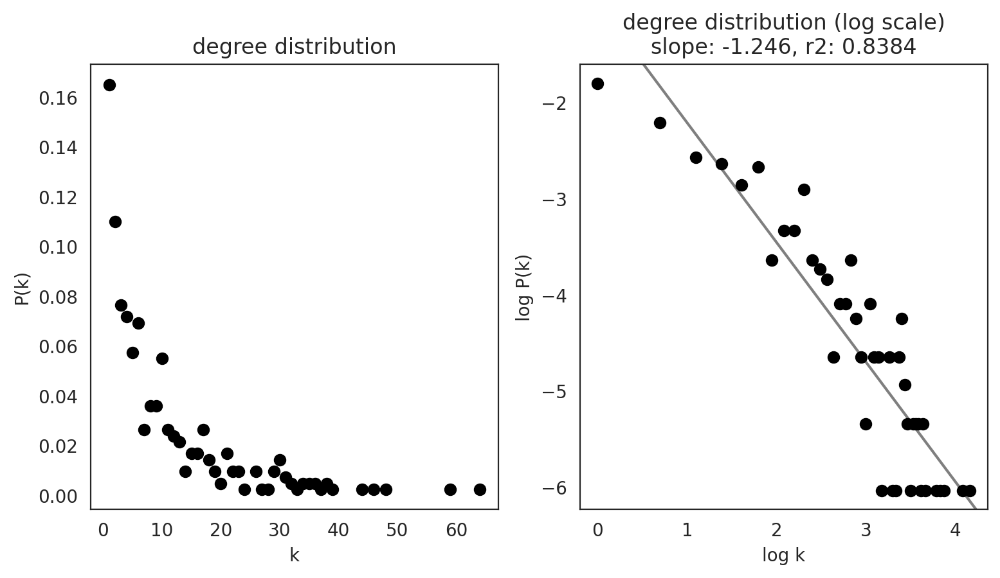

PER_23


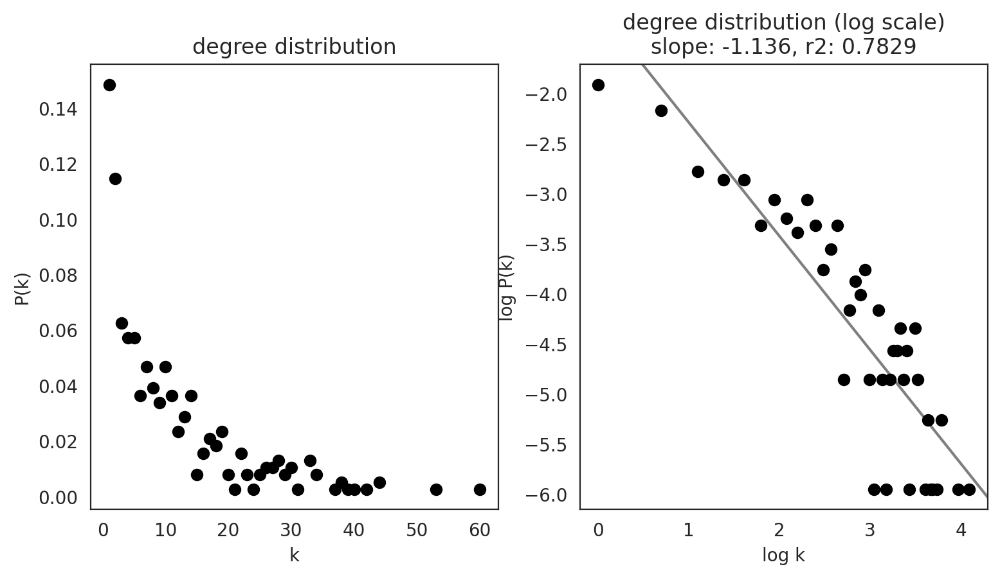

PER_24


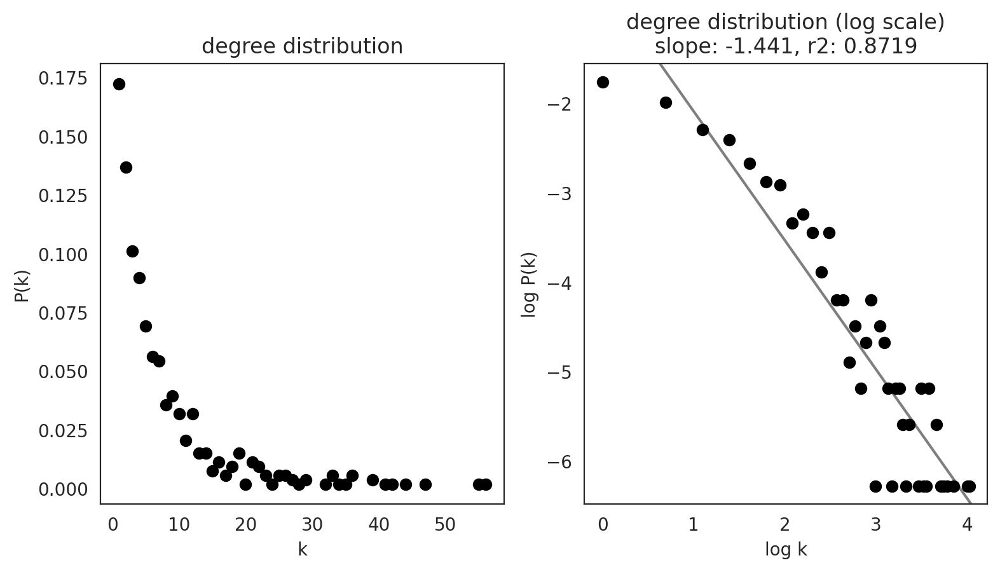

PER_25


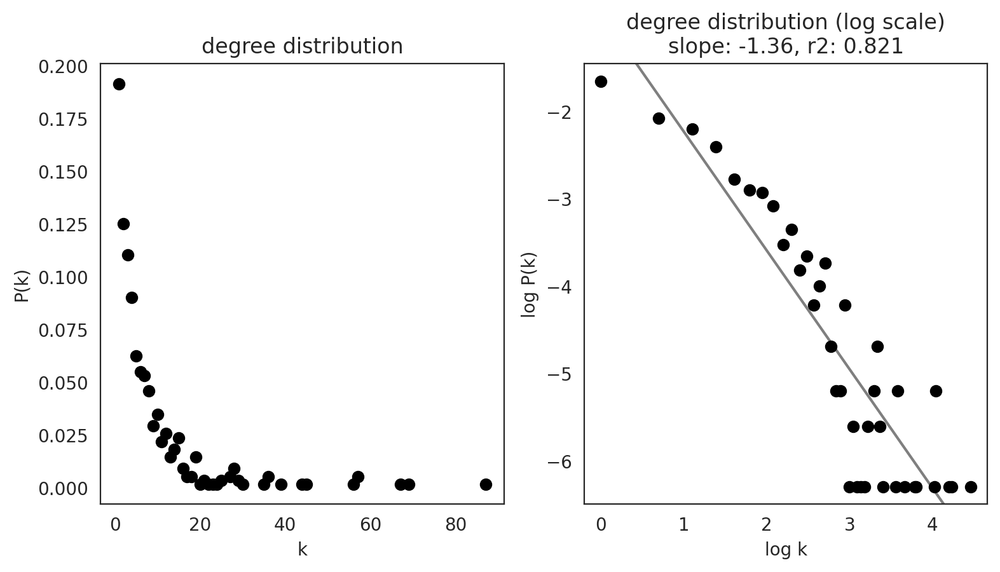

PER_3


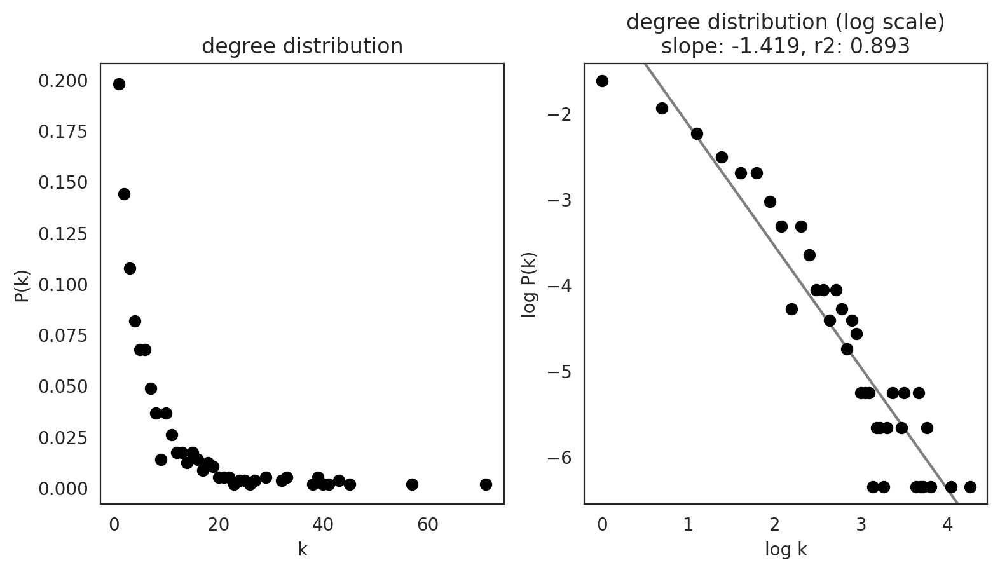

PER_4


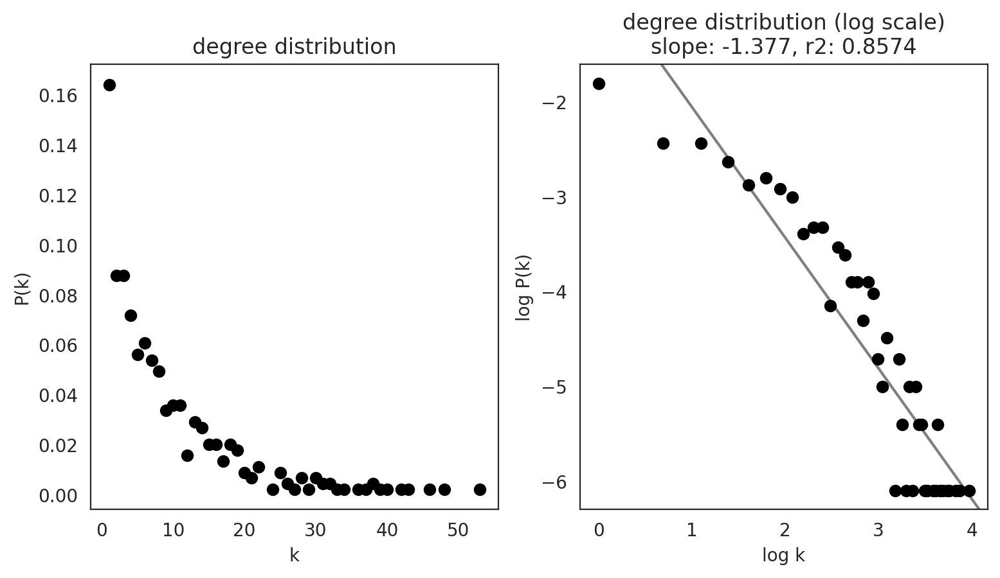

PER_5


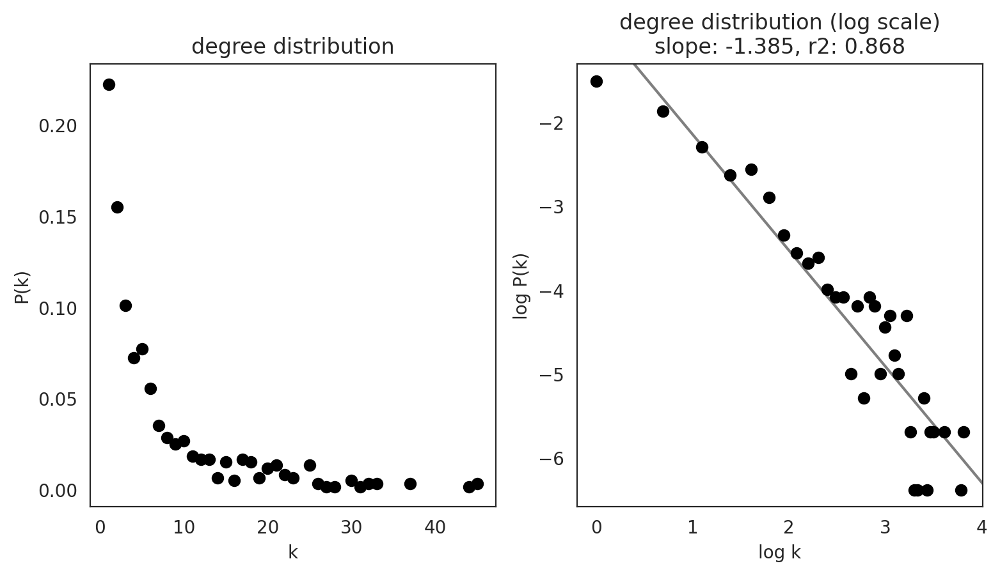

PER_6


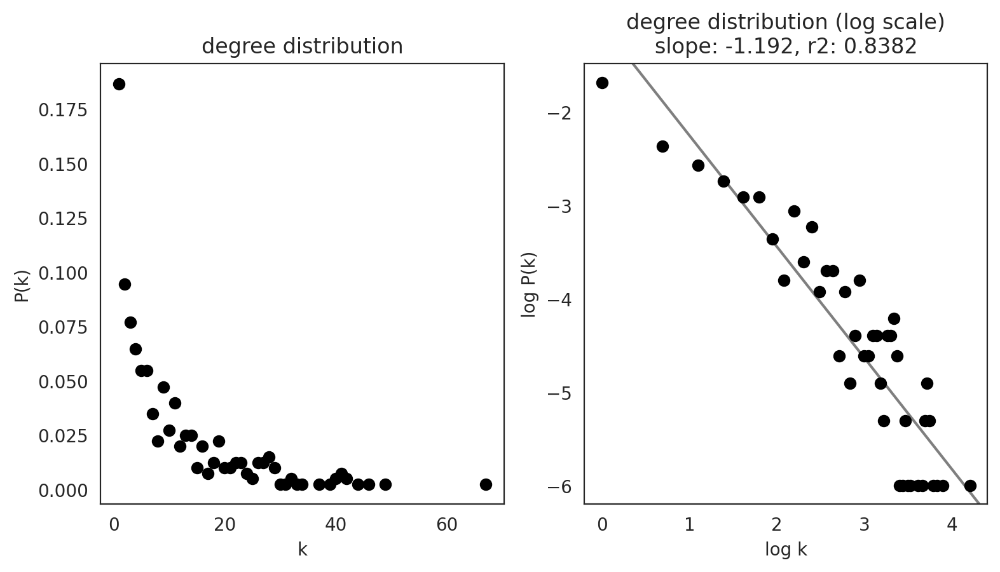

PER_7


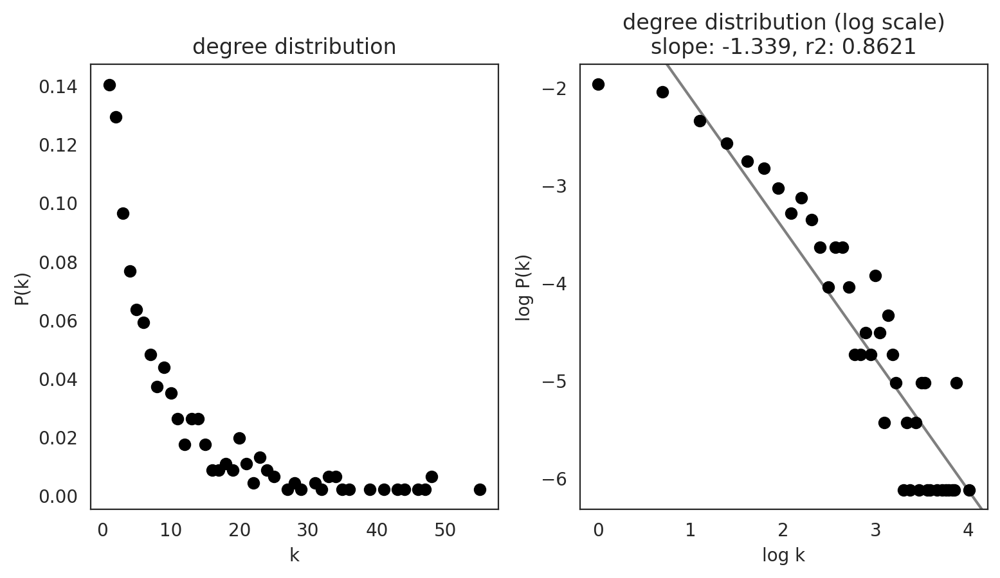

PER_8


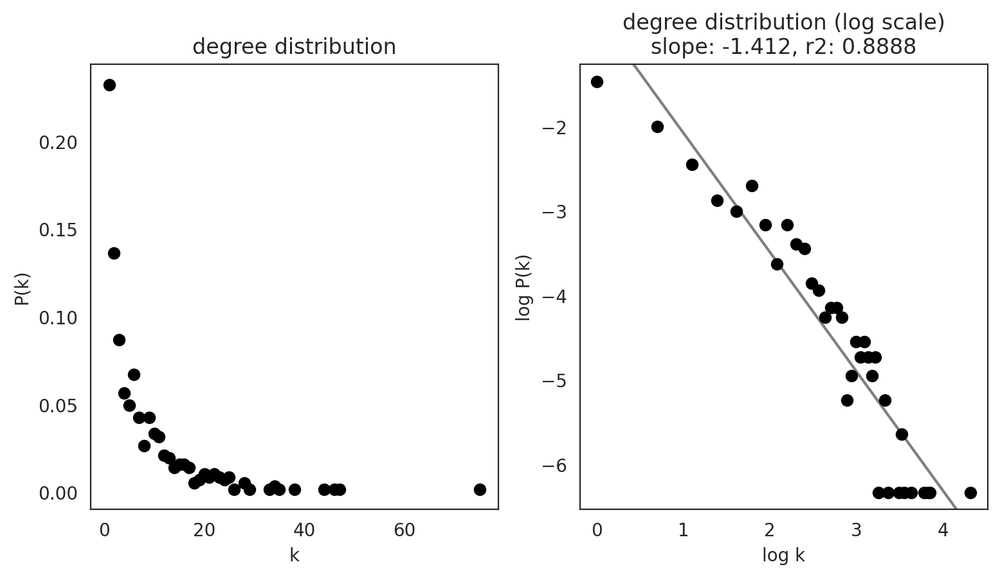

PER_9


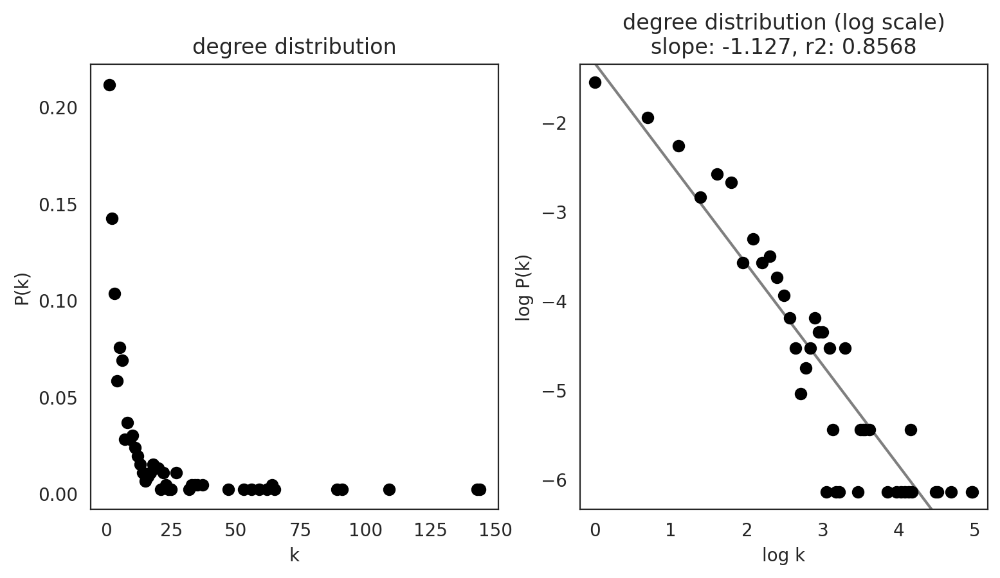

In [ ]:
links.plot_degree_distributions(plot_model=True,
                                               #save=f"{save_folder}/degree_distribution/",
                                               )

In [ ]:
links.get_network_score()


In [ ]:
links.to_hdf5(file_path="links.celloracle.links")


In [ ]:
links = co.load_hdf5(file_path="links.celloracle.links")


In [ ]:
links.filter_links()
oracle.get_cluster_specific_TFdict_from_Links(links_object=links)
oracle.fit_GRN_for_simulation(alpha=10,
                              use_cluster_specific_TFdict=True)

  0%|          | 0/56 [00:00<?, ?it/s]

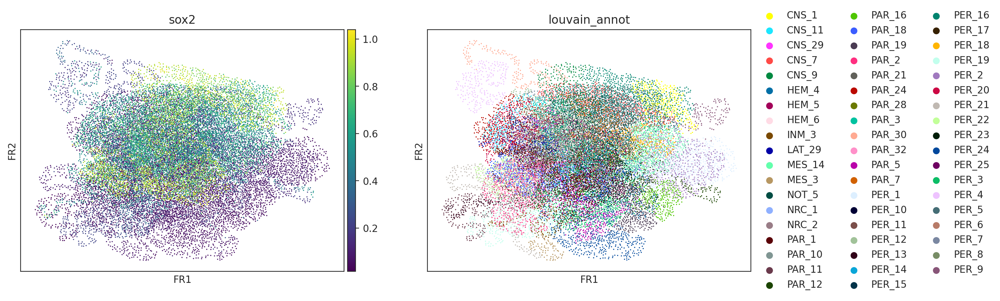

In [ ]:
goi = "tfap2a"
goi = "sox2"
# goi ='sardh'
sc.pl.draw_graph(oracle.adata, color=[goi, oracle.cluster_column_name],
                 layer="imputed_count", use_raw=False, cmap="viridis")

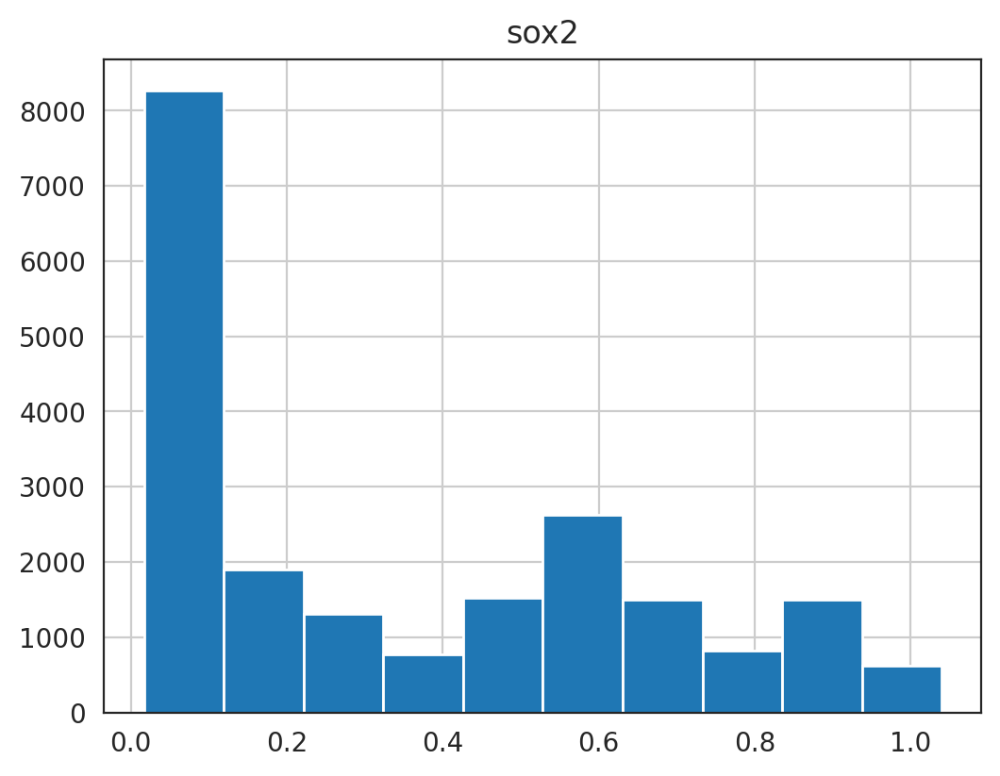

In [ ]:
sc.get.obs_df(oracle.adata, keys=[goi], layer="imputed_count").hist()
plt.show()


In [ ]:
oracle.simulate_shift(perturb_condition={goi: 0.0},
                      n_propagation=3)

In [ ]:
# Get transition probability
oracle.estimate_transition_prob(n_neighbors=200,
                                knn_random=True,
                                sampled_fraction=1)

# Calculate embedding
oracle.calculate_embedding_shift(sigma_corr=0.05)

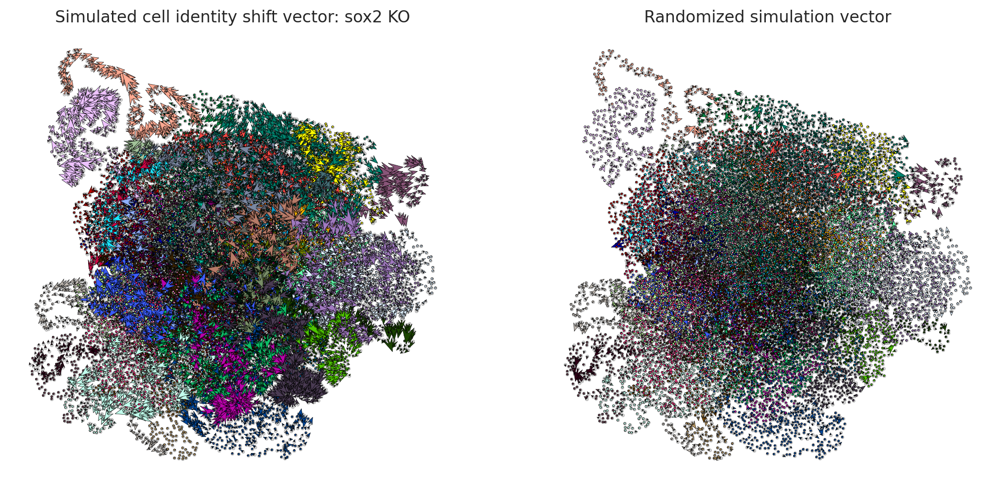

In [ ]:
fig, ax = plt.subplots(1, 2,  figsize=[13, 6])

scale = 25
# Show quiver plot
oracle.plot_quiver(scale=scale, ax=ax[0])
ax[0].set_title(f"Simulated cell identity shift vector: {goi} KO")

# Show quiver plot that was calculated with randomized graph.
oracle.plot_quiver_random(scale=scale, ax=ax[1])
ax[1].set_title(f"Randomized simulation vector")

plt.show()

In [ ]:
# n_grid = 40 is a good starting value.
n_grid = 100
oracle.calculate_p_mass(smooth=0.8, n_grid=n_grid, n_neighbors=200)


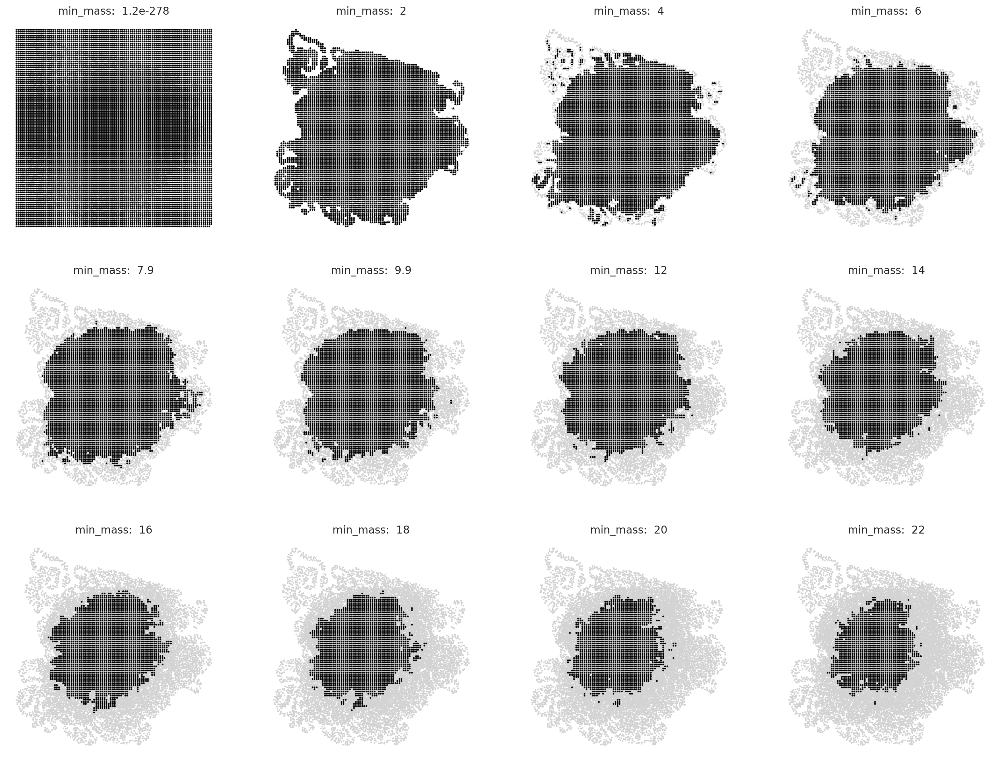

In [ ]:
oracle.suggest_mass_thresholds(n_suggestion=12)


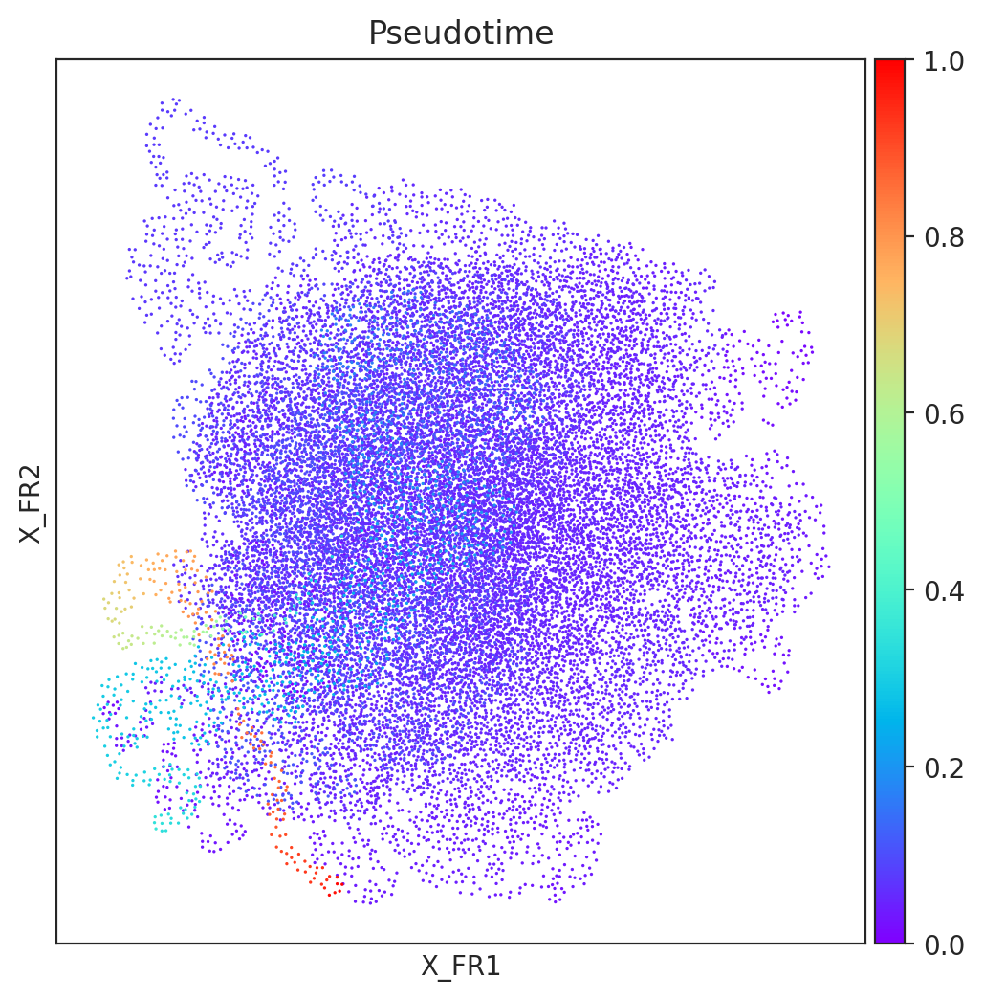

In [ ]:
fig, ax = plt.subplots(figsize=[6,6])

sc.pl.embedding(adata=oracle.adata, basis=oracle.embedding_name, ax=ax, cmap="rainbow",
                color=["Pseudotime"])

In [ ]:
from celloracle.applications import Gradient_calculator

# Instantiate Gradient calculator object
gradient = Gradient_calculator(oracle_object=oracle, pseudotime_key="Pseudotime")

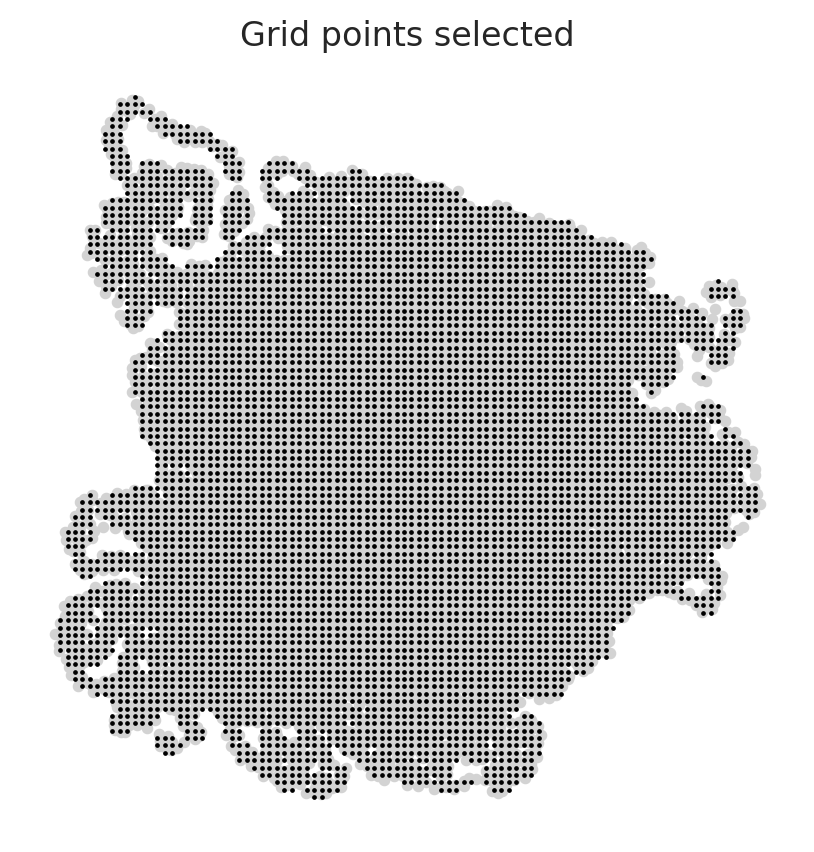

In [ ]:
gradient.calculate_p_mass(smooth=0.8, n_grid=n_grid, n_neighbors=200)
gradient.calculate_mass_filter(min_mass=2, plot=True)

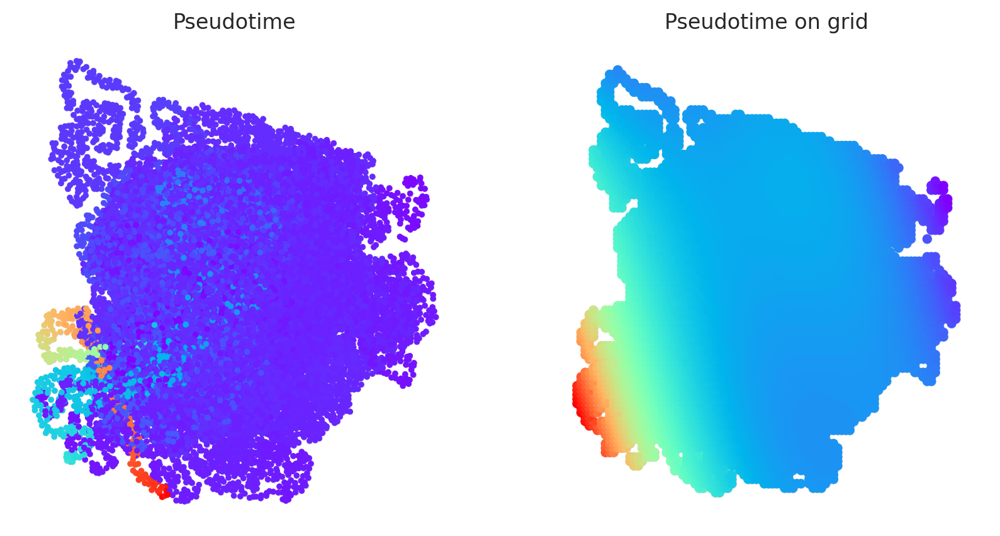

In [ ]:
gradient.transfer_data_into_grid(args={"method": "polynomial", "n_poly":3}, plot=True)


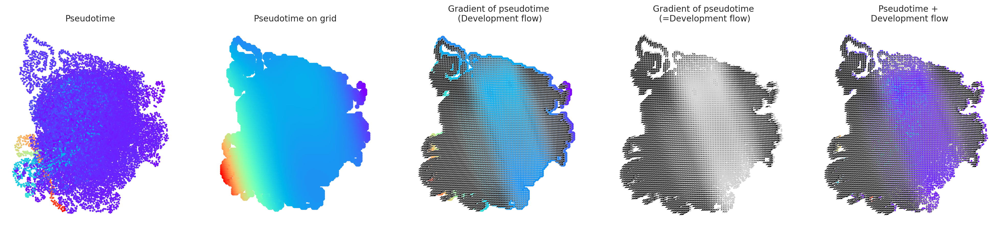

In [ ]:
gradient.calculate_gradient()

# Show results
scale_dev = 40
gradient.visualize_results(scale=scale_dev, s=5)

In [ ]:
from celloracle.applications import Oracle_development_module

# Make Oracle_development_module to compare two vector field
dev = Oracle_development_module()

# Load development flow
dev.load_differentiation_reference_data(gradient_object=gradient)

# Load simulation result
dev.load_perturb_simulation_data(oracle_object=oracle)


# Calculate inner produc scores
dev.calculate_inner_product()
dev.calculate_digitized_ip(n_bins=10)

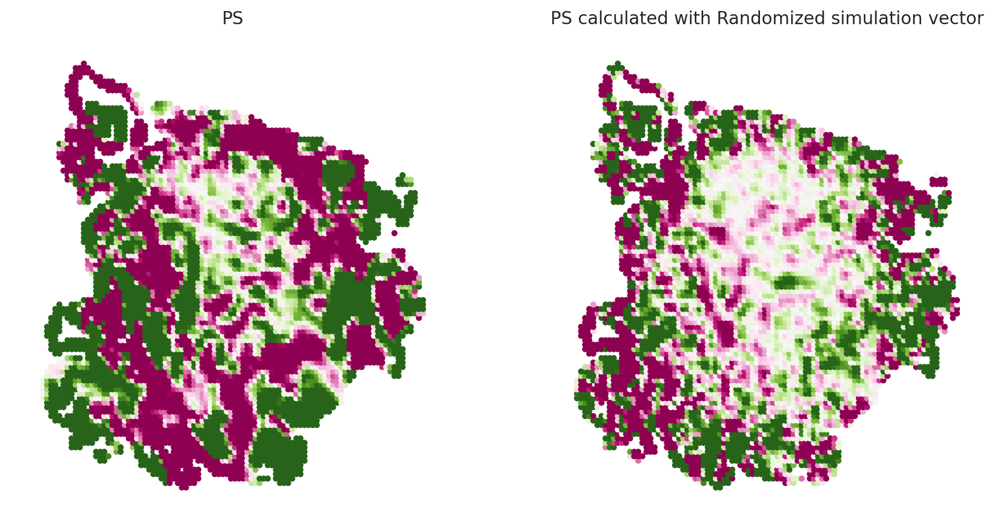

In [ ]:
vm = 0.01

fig, ax = plt.subplots(1, 2, figsize=[12, 6])
dev.plot_inner_product_on_grid(vm=0.02, s=10, ax=ax[0])
ax[0].set_title(f"PS")

dev.plot_inner_product_random_on_grid(vm=vm, s=10, ax=ax[1])
ax[1].set_title(f"PS calculated with Randomized simulation vector")
plt.show()

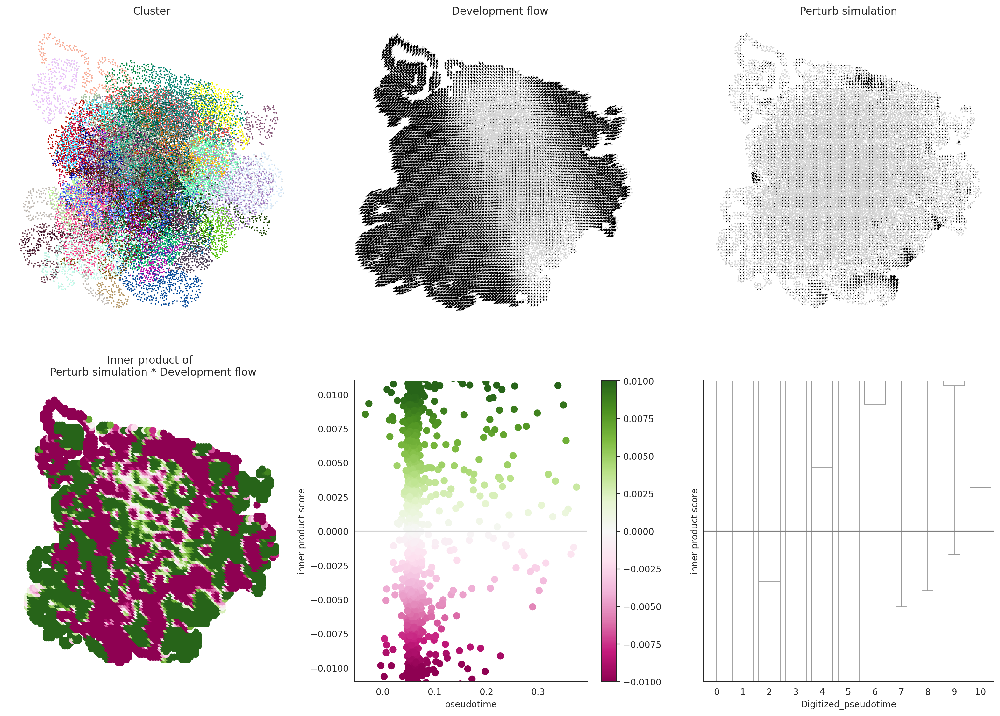

In [ ]:
# Let's visualize the results
dev.visualize_development_module_layout_0(s=2,
                                          s_grid=50,
                                          scale_for_pseudotime=scale_dev,
                                          vm=vm)